# Разведочный анализ данных (EDA)

**Разведочный анализ данных** (*Exploratory Data Analysis, EDA*) представляет собой процесс исследования данных с целью выявления основных характеристик, закономерностей, аномалий и трендов в них. Цель EDA заключается в том, чтобы получить предварительное представление о данных и лучше понять структуру их распределения.

Основные этапы разведочного анализа данных включают:

1. **Загрузка данных:** Получение доступа к набору данных, с которым вы планируете работать.

2. **Ознакомление с данными:** Просмотр первых нескольких строк данных, выявление общей структуры, типов переменных, наличие пропущенных значений.

3. **Описательная статистика:** Рассмотрение основных статистических характеристик данных, таких как среднее значение, медиана, минимум, максимум, стандартное отклонение.

4. **Визуализация данных:** Использование графиков и диаграмм для визуализации распределения данных, выявления выбросов, поиска корреляций и паттернов.

5. **Обработка выбросов и пропущенных значений:** Работа с аномальными значениями (выбросами) и пропущенными данными для улучшения качества анализа.

6. **Исследование корреляций:** Анализ взаимосвязей между переменными с использованием корреляционных матриц и других методов.

7. **Выделение основных характеристик групп данных:** Если данные содержат группы или категории, проведение анализа внутри каждой группы для выявления особенностей.

EDA представляет собой важный этап в подготовке данных перед построением моделей машинного обучения. Он помогает выявить потенциальные проблемы в данных, сделать предположения и сформулировать гипотезы, которые затем могут быть проверены более формальными методами анализа.

Некоторые открытые источники данных:
- Платформа для совревнований по машинному обучению [kaggle.com](https://www.kaggle.com/datasets)
- [Применение машинного обучения и Data Science в промышленности](https://vc.ru/ml/79368-primenenie-mashinnogo-obucheniya-i-data-science-v-promyshlennosti)
- https://paperswithcode.com/  
- https://huggingface.co/
- [Открытый репозиторий данных для машинного обучения](https://archive.ics.uci.edu/)
- [Datasets for Teaching and Learning](https://www.lib.ncsu.edu/formats/teaching-and-learning-datasets)
- [RESOURCES FOR EDUCATORS USING DATA IN THE CLASSROOM](https://oceansofdata.org/our-work/teacher-resources)
- [Open Access Dataset and Data Repositories](https://mira.mcmaster.ca/resources/data-repos-datasets/)
- [Лучшие бесплатные источники наборов данных для анализа](https://dzen.ru/a/XpYKOu2RAwxWSPNB)
- [Google Public datasets](https://console.cloud.google.com/marketplace/browse?filter=solution-type:dataset&_ga=2.108021314.1189173241.1701845625-1687434572.1701701128&pli=1)
- [OPEN DATA NETWORK](https://www.opendatanetwork.com/)
- [Google Dataset Search](https://datasetsearch.research.google.com/)

# Import modules

In [1]:
# Импорт необходимых библиотек
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Импорт моделей для обнаружения выбросов
from sklearn.ensemble import IsolationForest
from sklearn.svm import OneClassSVM
from sklearn.neighbors import LocalOutlierFactor

# новая для нас библиотека Plotly Express обычно сокращается как px
import plotly.express as px

# Сборщик мусора для управления памятью
import gc

# Настройка стилей графиков
sns.set()
%matplotlib inline

# Настройки вывода чисел с плавающей точкой
import sys
np.set_printoptions(suppress=True)
np.set_printoptions(threshold=sys.maxsize)
np.set_printoptions(precision=3)

# Максимальное количество строк для отображения в DataFrame
DISPLAY_MAX_ROWS = 100 # 20
pd.set_option('display.max_rows', DISPLAY_MAX_ROWS)
pd.set_option('display.max_column', 100)  # None)

# Настройка стиля графиков Matplotlib
# plt.style.use('seaborn-whitegrid')

# Установка размеров графиков по умолчанию
# plt.rcParams["figure.figsize"] = (20, 15)

# Игнорирование предупреждений
import warnings
warnings.filterwarnings('ignore')

# Включить автозаполнение Jupyter Notebook
%config IPCompleter.greedy=True

# Датасет autos/cars. Описание данных

Attribute: Attribute Range

1. **symboling**:                -3, -2, -1, 0, 1, 2, 3.
2. **normalized-losses**:        continuous from 65 to 256.
3. **make**:                     
                               alfa-romero, audi, bmw, chevrolet, dodge, honda,
                               isuzu, jaguar, mazda, mercedes-benz, mercury,
                               mitsubishi, nissan, peugot, plymouth, porsche,
                               renault, saab, subaru, toyota, volkswagen, volvo

4. **fuel-type**:                diesel, gas.
5. **spiration**:               std, turbo.
6. **num-of-doors**:             four, two.
7. **body-style**:               hardtop, wagon, sedan, hatchback, convertible.
8. **drive-wheels**:             4wd, fwd, rwd.
9. **engine-location**:          front, rear.
10. **wheel-base**:               continuous from 86.6 120.9.
11. **length**:                   continuous from 141.1 to 208.1.
12. **width**:                    continuous from 60.3 to 72.3.
13. **height**:                   continuous from 47.8 to 59.8.
14. **curb-weight**:              continuous from 1488 to 4066.
15. **engine-type**:              dohc, dohcv, l, ohc, ohcf, ohcv, rotor.
16. **num-of-cylinders**:         eight, five, four, six, three, twelve, two.
17. **engine-size**:              continuous from 61 to 326.
18. **fuel-system**:              1bbl, 2bbl, 4bbl, idi, mfi, mpfi, spdi, spfi.
19. **bore**:                     continuous from 2.54 to 3.94.
20. **stroke**:                   continuous from 2.07 to 4.17.
21. **compression-ratio**:        continuous from 7 to 23.
22. **horsepower**:               continuous from 48 to 288.
23. **peak-rpm**:                 continuous from 4150 to 6600.
24. **city-mpg**:                 continuous from 13 to 49.
25. **highway-mpg**:              continuous from 16 to 54.
26. **price**:                    continuous from 5118 to 45400.

# Загрузка данных

In [2]:
# Загрузка данных
url = "https://archive.ics.uci.edu/ml/machine-learning-databases/autos/imports-85.data"
columns = ["symboling", "normalized-losses", "make", "fuel-type", "aspiration", "num-of-doors",
           "body-style", "drive-wheels", "engine-location", "wheel-base", "length", "width",
           "height", "curb-weight", "engine-type", "num-of-cylinders", "engine-size",
           "fuel-system", "bore", "stroke", "compression-ratio", "horsepower", "peak-rpm",
           "city-mpg", "highway-mpg", "price"]
df = pd.read_csv(url, names=columns, na_values="?")

In [3]:
df 

,symboling,normalized-losses,make,fuel-type,aspiration,num-of-doors,body-style,drive-wheels,engine-location,wheel-base,length,width,height,curb-weight,engine-type,num-of-cylinders,engine-size,fuel-system,bore,stroke,compression-ratio,horsepower,peak-rpm,city-mpg,highway-mpg,price
0,3,NaN,alfa-romero,gas,std,two,convertible,rwd,front,88.6,168.8,64.1,48.8,2548,dohc,four,130,mpfi,3.47,2.68,9.0,111.0,5000.0,21,27,13495.0
1,3,NaN,alfa-romero,gas,std,two,convertible,rwd,front,88.6,168.8,64.1,48.8,2548,dohc,four,130,mpfi,3.47,2.68,9.0,111.0,5000.0,21,27,16500.0
2,1,NaN,alfa-romero,gas,std,two,hatchback,rwd,front,94.5,171.2,65.5,52.4,2823,ohcv,six,152,mpfi,2.68,3.47,9.0,154.0,5000.0,19,26,16500.0
3,2,164.0,audi,gas,std,four,sedan,fwd,front,99.8,176.6,66.2,54.3,2337,ohc,four,109,mpfi,3.19,3.40,10.0,102.0,5500.0,24,30,13950.0
4,2,164.0,audi,gas,std,four,sedan,4wd,front,99.4,176.6,66.4,54.3,2824,ohc,five,136,mpfi,3.19,3.40,8.0,115.0,5500.0,18,22,17450.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
200,-1,95.0,volvo,gas,std,four,sedan,rwd,front,109.1,188.8,68.9,55.5,2952,ohc,four,141,mpfi,3.78,3.15,9.5,114.0,5400.0,23,28,16845.0
201,-1,95.0,volvo,gas,turbo,four,sedan,rwd,front,109.1,188.8,68.8,55.5,3049,ohc,four,141,mpfi,3.78,3.15,8.7,160.0,5300.0,19,25,19045.0
202,-1,95.0,volvo,gas,std,four,sedan,rwd,front,109.1,188.8,68.9,55.5,3012,ohcv,six,173,mpfi,3.58,2.87,8.8,134.0,5500.0,18,23,21485.0
203,-1,95.0,volvo,diesel,turbo,four,sedan,rwd,front,109.1,188.8,68.9,55.5,3217,ohc,six,145,idi,3.01,3.40,23.0,106.0,4800.0,26,27,22470.0


In [5]:
df.head() # первые 5 строчек

,symboling,normalized-losses,make,fuel-type,aspiration,num-of-doors,body-style,drive-wheels,engine-location,wheel-base,length,width,height,curb-weight,engine-type,num-of-cylinders,engine-size,fuel-system,bore,stroke,compression-ratio,horsepower,peak-rpm,city-mpg,highway-mpg,price
0,3,NaN,alfa-romero,gas,std,two,convertible,rwd,front,88.6,168.8,64.1,48.8,2548,dohc,four,130,mpfi,3.47,2.68,9.0,111.0,5000.0,21,27,13495.0
1,3,NaN,alfa-romero,gas,std,two,convertible,rwd,front,88.6,168.8,64.1,48.8,2548,dohc,four,130,mpfi,3.47,2.68,9.0,111.0,5000.0,21,27,16500.0
2,1,NaN,alfa-romero,gas,std,two,hatchback,rwd,front,94.5,171.2,65.5,52.4,2823,ohcv,six,152,mpfi,2.68,3.47,9.0,154.0,5000.0,19,26,16500.0
3,2,164.0,audi,gas,std,four,sedan,fwd,front,99.8,176.6,66.2,54.3,2337,ohc,four,109,mpfi,3.19,3.40,10.0,102.0,5500.0,24,30,13950.0
4,2,164.0,audi,gas,std,four,sedan,4wd,front,99.4,176.6,66.4,54.3,2824,ohc,five,136,mpfi,3.19,3.40,8.0,115.0,5500.0,18,22,17450.0


In [6]:
df.tail() # последние 5 строчек

,symboling,normalized-losses,make,fuel-type,aspiration,num-of-doors,body-style,drive-wheels,engine-location,wheel-base,length,width,height,curb-weight,engine-type,num-of-cylinders,engine-size,fuel-system,bore,stroke,compression-ratio,horsepower,peak-rpm,city-mpg,highway-mpg,price
200,-1,95.0,volvo,gas,std,four,sedan,rwd,front,109.1,188.8,68.9,55.5,2952,ohc,four,141,mpfi,3.78,3.15,9.5,114.0,5400.0,23,28,16845.0
201,-1,95.0,volvo,gas,turbo,four,sedan,rwd,front,109.1,188.8,68.8,55.5,3049,ohc,four,141,mpfi,3.78,3.15,8.7,160.0,5300.0,19,25,19045.0
202,-1,95.0,volvo,gas,std,four,sedan,rwd,front,109.1,188.8,68.9,55.5,3012,ohcv,six,173,mpfi,3.58,2.87,8.8,134.0,5500.0,18,23,21485.0
203,-1,95.0,volvo,diesel,turbo,four,sedan,rwd,front,109.1,188.8,68.9,55.5,3217,ohc,six,145,idi,3.01,3.40,23.0,106.0,4800.0,26,27,22470.0
204,-1,95.0,volvo,gas,turbo,four,sedan,rwd,front,109.1,188.8,68.9,55.5,3062,ohc,four,141,mpfi,3.78,3.15,9.5,114.0,5400.0,19,25,22625.0


In [7]:
df.sample(10) # случайная выборка

,symboling,normalized-losses,make,fuel-type,aspiration,num-of-doors,body-style,drive-wheels,engine-location,wheel-base,length,width,height,curb-weight,engine-type,num-of-cylinders,engine-size,fuel-system,bore,stroke,compression-ratio,horsepower,peak-rpm,city-mpg,highway-mpg,price
92,1,122.0,nissan,gas,std,four,sedan,fwd,front,94.5,165.3,63.8,54.5,1938,ohc,four,97,2bbl,3.15,3.29,9.4,69.0,5200.0,31,37,6849.0
75,1,NaN,mercury,gas,turbo,two,hatchback,rwd,front,102.7,178.4,68.0,54.8,2910,ohc,four,140,mpfi,3.78,3.12,8.0,175.0,5000.0,19,24,16503.0
136,3,150.0,saab,gas,turbo,two,hatchback,fwd,front,99.1,186.6,66.5,56.1,2808,dohc,four,121,mpfi,3.54,3.07,9.0,160.0,5500.0,19,26,18150.0
202,-1,95.0,volvo,gas,std,four,sedan,rwd,front,109.1,188.8,68.9,55.5,3012,ohcv,six,173,mpfi,3.58,2.87,8.8,134.0,5500.0,18,23,21485.0
72,3,142.0,mercedes-benz,gas,std,two,convertible,rwd,front,96.6,180.3,70.5,50.8,3685,ohcv,eight,234,mpfi,3.46,3.10,8.3,155.0,4750.0,16,18,35056.0
120,1,154.0,plymouth,gas,std,four,hatchback,fwd,front,93.7,157.3,63.8,50.6,1967,ohc,four,90,2bbl,2.97,3.23,9.4,68.0,5500.0,31,38,6229.0
33,1,101.0,honda,gas,std,two,hatchback,fwd,front,93.7,150.0,64.0,52.6,1940,ohc,four,92,1bbl,2.91,3.41,9.2,76.0,6000.0,30,34,6529.0
171,2,134.0,toyota,gas,std,two,hatchback,rwd,front,98.4,176.2,65.6,52.0,2714,ohc,four,146,mpfi,3.62,3.50,9.3,116.0,4800.0,24,30,11549.0
32,1,101.0,honda,gas,std,two,hatchback,fwd,front,93.7,150.0,64.0,52.6,1837,ohc,four,79,1bbl,2.91,3.07,10.1,60.0,5500.0,38,42,5399.0
102,0,108.0,nissan,gas,std,four,wagon,fwd,front,100.4,184.6,66.5,56.1,3296,ohcv,six,181,mpfi,3.43,3.27,9.0,152.0,5200.0,17,22,14399.0


In [8]:
df.info() # информация по датасету

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 205 entries, 0 to 204
Data columns (total 26 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   symboling          205 non-null    int64  
 1   normalized-losses  164 non-null    float64
 2   make               205 non-null    object 
 3   fuel-type          205 non-null    object 
 4   aspiration         205 non-null    object 
 5   num-of-doors       203 non-null    object 
 6   body-style         205 non-null    object 
 7   drive-wheels       205 non-null    object 
 8   engine-location    205 non-null    object 
 9   wheel-base         205 non-null    float64
 10  length             205 non-null    float64
 11  width              205 non-null    float64
 12  height             205 non-null    float64
 13  curb-weight        205 non-null    int64  
 14  engine-type        205 non-null    object 
 15  num-of-cylinders   205 non-null    object 
 16  engine-size        205 non

In [9]:
df.shape # размерность

(205, 26)

In [10]:
df.dtypes # тип данных

symboling              int64
normalized-losses    float64
make                  object
fuel-type             object
aspiration            object
num-of-doors          object
body-style            object
drive-wheels          object
engine-location       object
wheel-base           float64
length               float64
width                float64
height               float64
curb-weight            int64
engine-type           object
num-of-cylinders      object
engine-size            int64
fuel-system           object
bore                 float64
stroke               float64
compression-ratio    float64
horsepower           float64
peak-rpm             float64
city-mpg               int64
highway-mpg            int64
price                float64
dtype: object

In [11]:
df.describe() # описательная статистика только для столбцов с числовым значением

,symboling,normalized-losses,wheel-base,length,width,height,curb-weight,engine-size,bore,stroke,compression-ratio,horsepower,peak-rpm,city-mpg,highway-mpg,price
count,205.000000,164.000000,205.000000,205.000000,205.000000,205.000000,205.000000,205.000000,201.000000,201.000000,205.000000,203.000000,203.000000,205.000000,205.000000,201.000000
mean,0.834146,122.000000,98.756585,174.049268,65.907805,53.724878,2555.565854,126.907317,3.329751,3.255423,10.142537,104.256158,5125.369458,25.219512,30.751220,13207.129353
std,1.245307,35.442168,6.021776,12.337289,2.145204,2.443522,520.680204,41.642693,0.273539,0.316717,3.972040,39.714369,479.334560,6.542142,6.886443,7947.066342
min,-2.000000,65.000000,86.600000,141.100000,60.300000,47.800000,1488.000000,61.000000,2.540000,2.070000,7.000000,48.000000,4150.000000,13.000000,16.000000,5118.000000
25%,0.000000,94.000000,94.500000,166.300000,64.100000,52.000000,2145.000000,97.000000,3.150000,3.110000,8.600000,70.000000,4800.000000,19.000000,25.000000,7775.000000
50%,1.000000,115.000000,97.000000,173.200000,65.500000,54.100000,2414.000000,120.000000,3.310000,3.290000,9.000000,95.000000,5200.000000,24.000000,30.000000,10295.000000
75%,2.000000,150.000000,102.400000,183.100000,66.900000,55.500000,2935.000000,141.000000,3.590000,3.410000,9.400000,116.000000,5500.000000,30.000000,34.000000,16500.000000
max,3.000000,256.000000,120.900000,208.100000,72.300000,59.800000,4066.000000,326.000000,3.940000,4.170000,23.000000,288.000000,6600.000000,49.000000,54.000000,45400.000000


In [12]:
df.describe(include=['object']) # описательная статистика с учетом категориальных переменных

,make,fuel-type,aspiration,num-of-doors,body-style,drive-wheels,engine-location,engine-type,num-of-cylinders,fuel-system
count,205,205,205,203,205,205,205,205,205,205
unique,22,2,2,2,5,3,2,7,7,8
top,toyota,gas,std,four,sedan,fwd,front,ohc,four,mpfi
freq,32,185,168,114,96,120,202,148,159,94


In [13]:
df.columns # названия столбцов

Index(['symboling', 'normalized-losses', 'make', 'fuel-type', 'aspiration',
       'num-of-doors', 'body-style', 'drive-wheels', 'engine-location',
       'wheel-base', 'length', 'width', 'height', 'curb-weight', 'engine-type',
       'num-of-cylinders', 'engine-size', 'fuel-system', 'bore', 'stroke',
       'compression-ratio', 'horsepower', 'peak-rpm', 'city-mpg',
       'highway-mpg', 'price'],
      dtype='object')

# Pandas profiling

In [6]:
from ydata_profiling import ProfileReport

In [8]:
profile_autos = ProfileReport(df, title="Profiling Report_autos")
profile_autos

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# Sweetviz

[EDA становится проще, если есть SWEETVIZ](https://habr.com/ru/articles/564172/)

                                             |          | [  0%]   00:00 -> (? left)


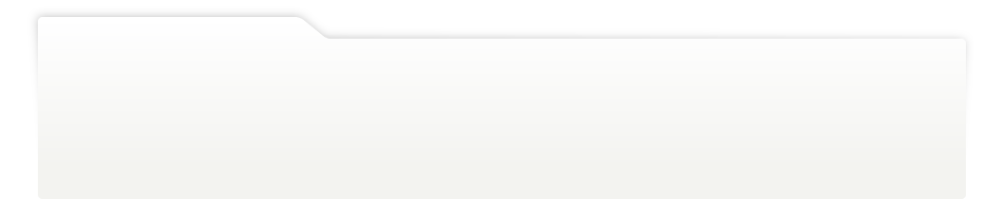
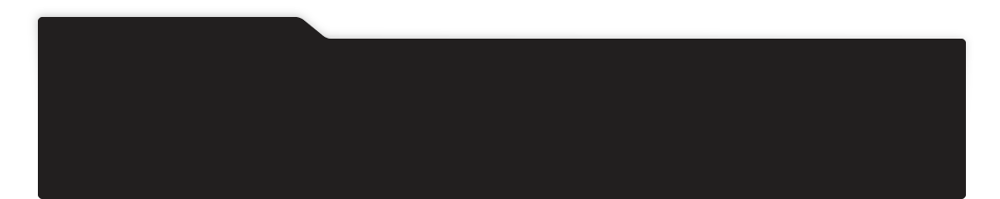
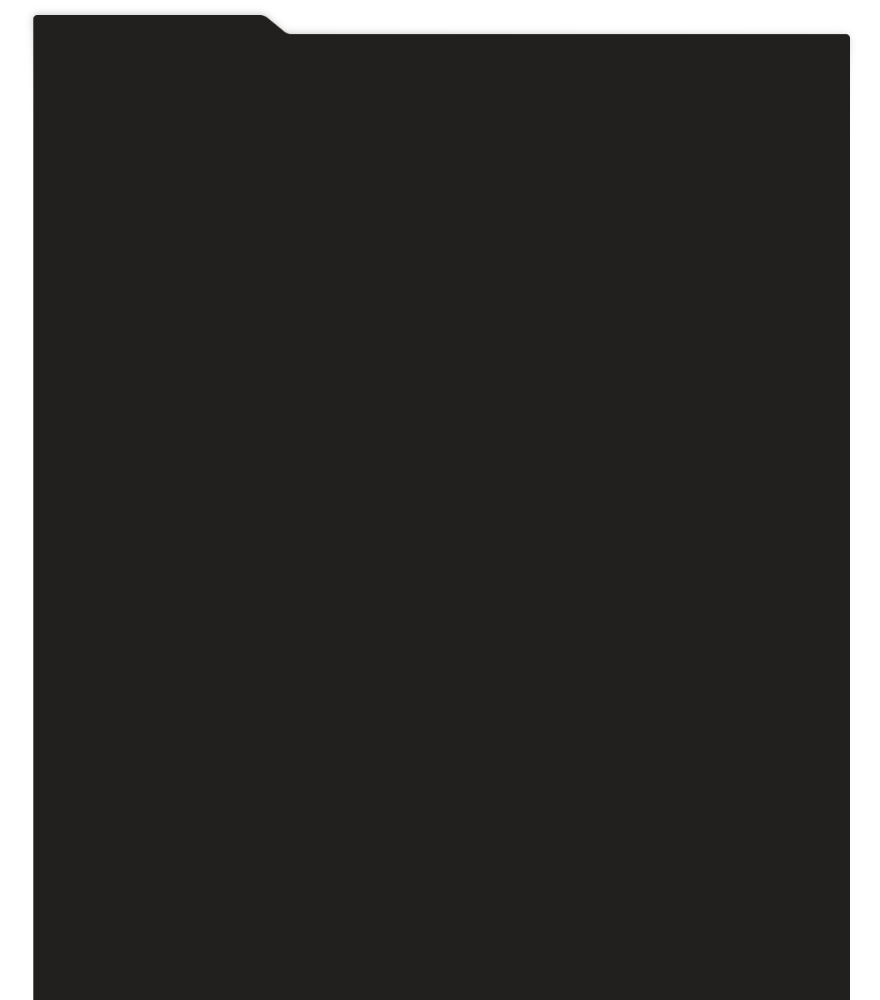
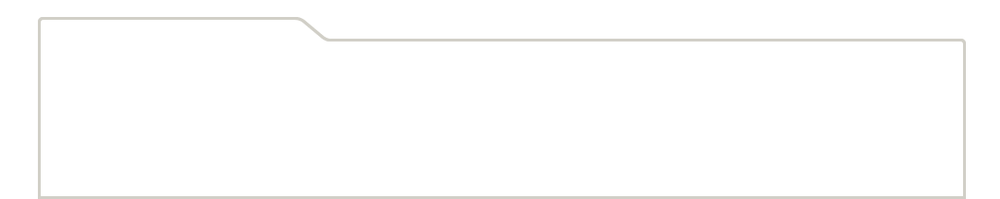
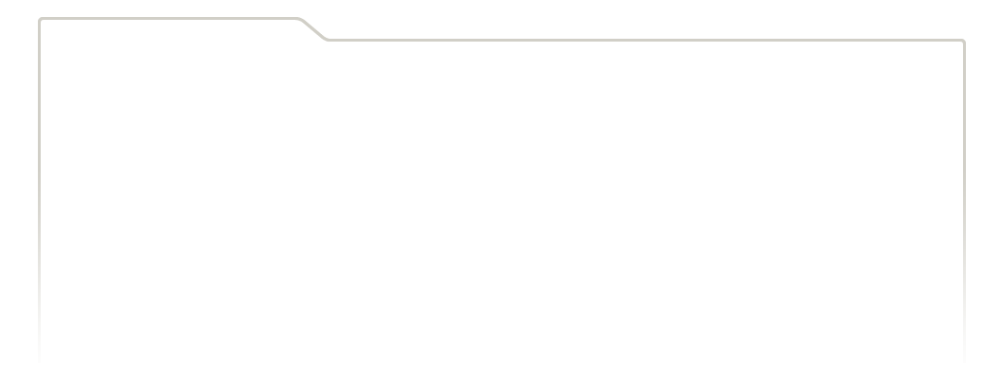
...
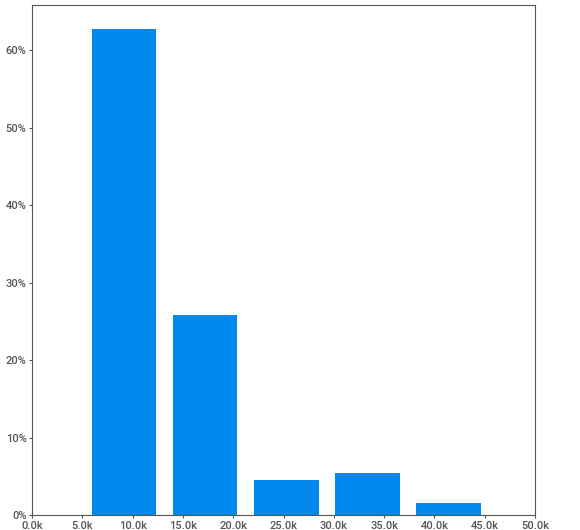
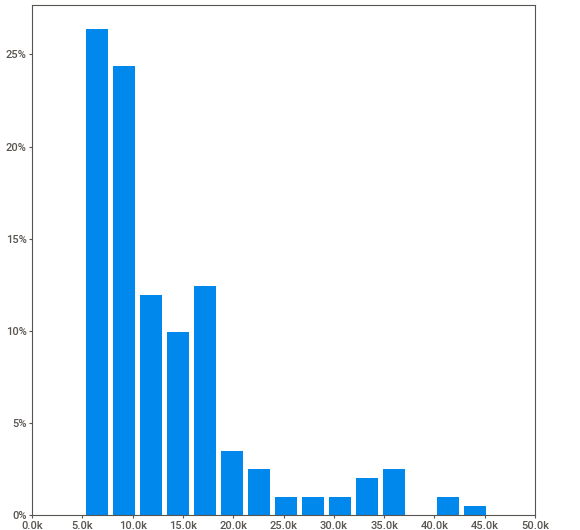
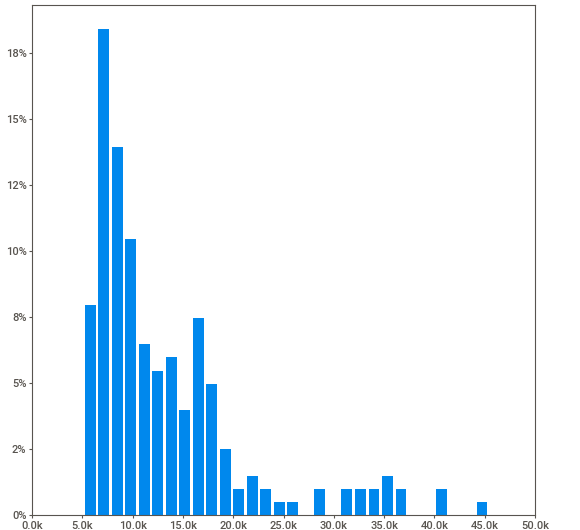
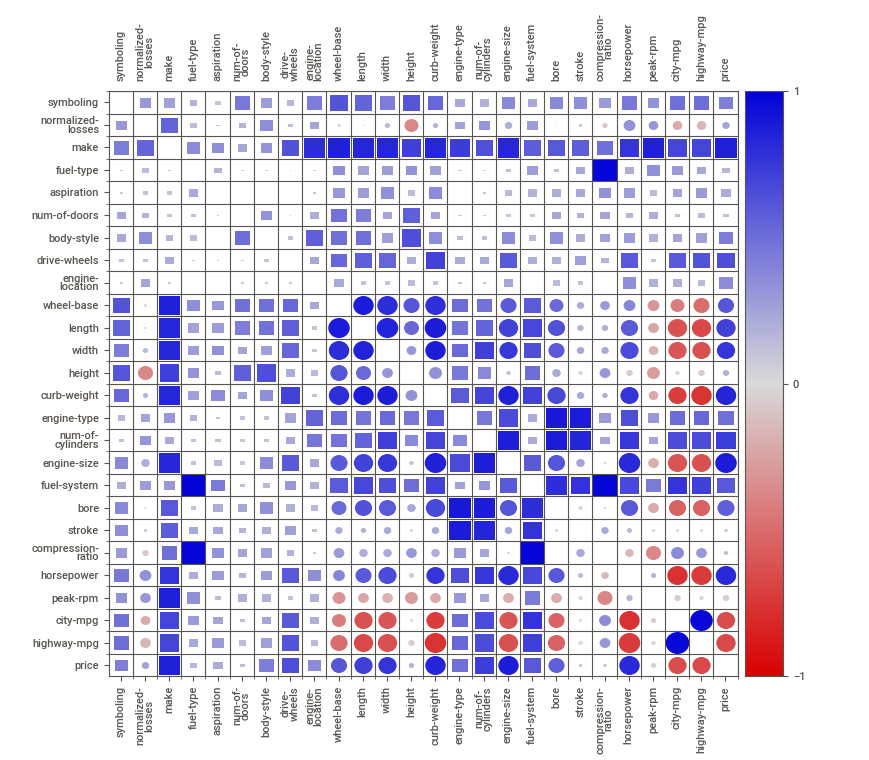
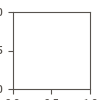

In [12]:
import sweetviz as sv

# передадим оба датасета в функцию sv.comparison()
report = sv.analyze([df, "Autos"])

# применим метод .show_notebook()
report.show_notebook()

# Визуализация

In [14]:
# df[['make', 'fuel-type', 'aspiration', 'num-of-doors',
#     'body-style', 'drive-wheels', 'engine-location', 'engine-type',
#     'num-of-cylinders', 'fuel-system']].value_counts()

`countplot` в библиотеке Seaborn используется для отображения количества наблюдений в каждой категории категориальной переменной. Этот тип графика полезен для визуализации распределения частот внутри категорий. Когда вы передаете `x` или `y` и `data` в `countplot`, Seaborn считает количество наблюдений для каждой уникальной категории в выбранном столбце.

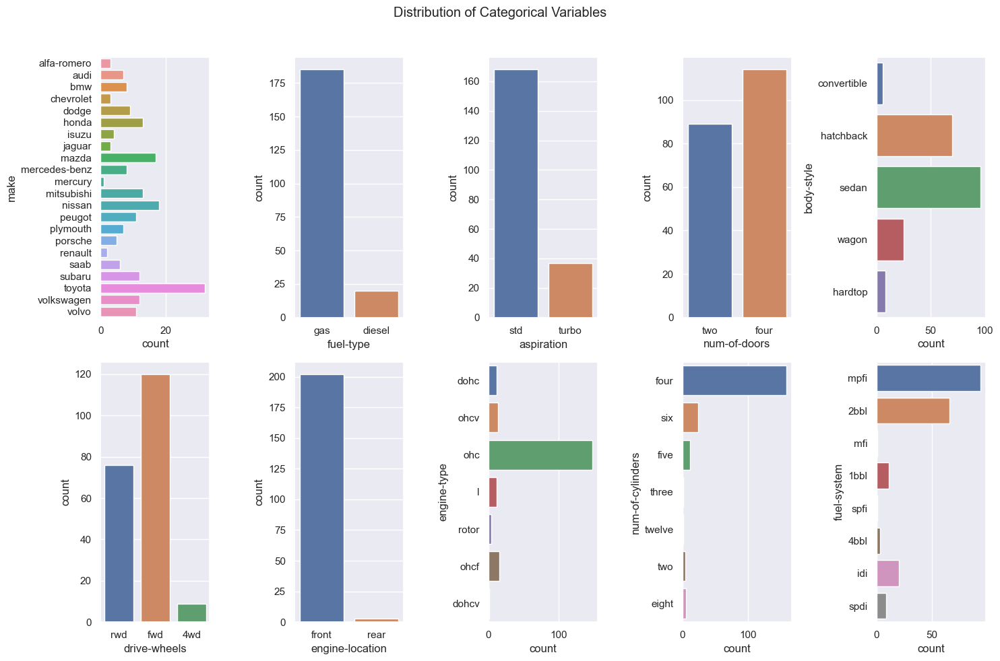

In [15]:
# Список категориальных столбцов для анализа
column_object = ['make', 'fuel-type', 'aspiration', 'num-of-doors',
    'body-style', 'drive-wheels', 'engine-location', 'engine-type',
    'num-of-cylinders', 'fuel-system']

# Создание сетки графиков размером 2x5
fig, axes = plt.subplots(2, 5, figsize=(15, 10))

# Отрисовка графика для каждого категориального столбца
sns.countplot(y=df['make'], data=df, ax=axes[0, 0])
sns.countplot(x=df['fuel-type'], data=df, ax=axes[0, 1])
sns.countplot(x=df['aspiration'], data=df, ax=axes[0, 2])
sns.countplot(x=df['num-of-doors'], data=df, ax=axes[0, 3])
sns.countplot(y=df['body-style'], data=df, ax=axes[0, 4])
sns.countplot(x=df['drive-wheels'], data=df, ax=axes[1, 0])
sns.countplot(x=df['engine-location'], data=df, ax=axes[1, 1])
sns.countplot(y=df['engine-type'], data=df, ax=axes[1, 2])
sns.countplot(y=df['num-of-cylinders'], data=df, ax=axes[1, 3])
sns.countplot(y=df['fuel-system'], data=df, ax=axes[1, 4])

# Добавление подписей и настройка внешнего вида графиков
fig.suptitle('Distribution of Categorical Variables')
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()


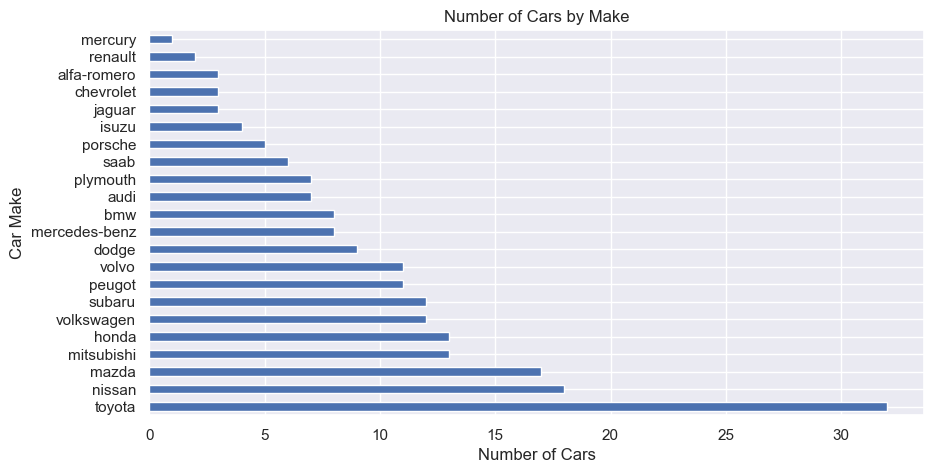

In [16]:
# Вычисление количества уникальных значений в столбце 'make'
nunique_make = df['make'].value_counts()

# Создание горизонтальной столбчатой диаграммы
axes = nunique_make.plot(kind='barh', figsize=(10, 5))

# Добавление подписей к графику
axes.set_title('Number of Cars by Make')
axes.set_xlabel('Number of Cars')
axes.set_ylabel('Car Make')

# Отображение графика
plt.show()


Этот код создает для каждого числового столбца три графика:
1. **Violin plot**: Показывает распределение данных, включая ядерную оценку плотности.
2. **Histogram с KDE (Kernel Density Estimation)**: Показывает распределение данных в виде столбцов и гладкой кривой KDE.
3. **Box plot (ящик с усами)**: Позволяет оценить основные статистические характеристики, такие как медиана, квартили и наличие выбросов. Он помогает нам быстро оценить разброс и симметрию данных, а также выявить потенциальные аномалии.

**********START**********


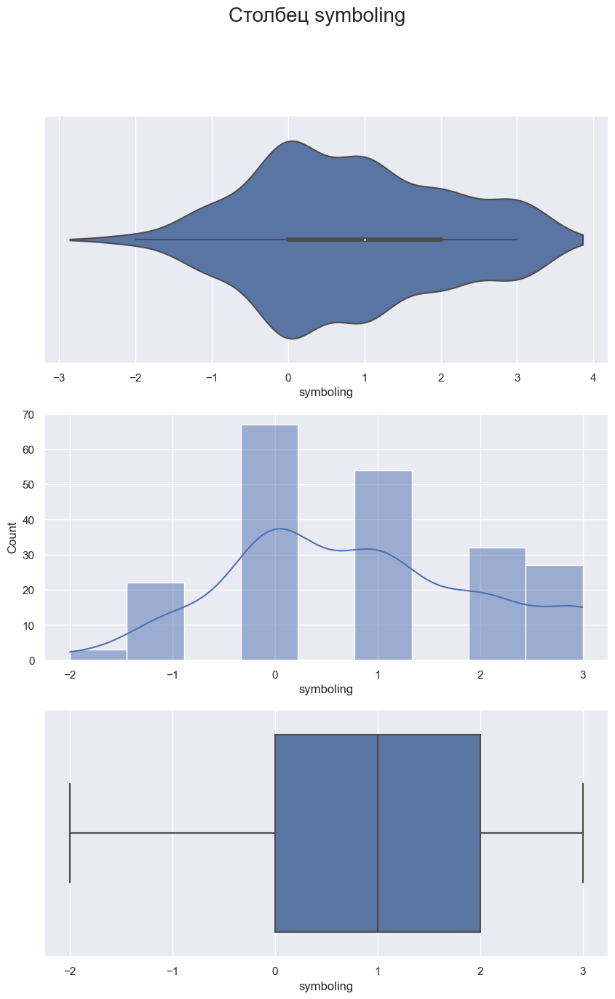

**********END**********

**********START**********


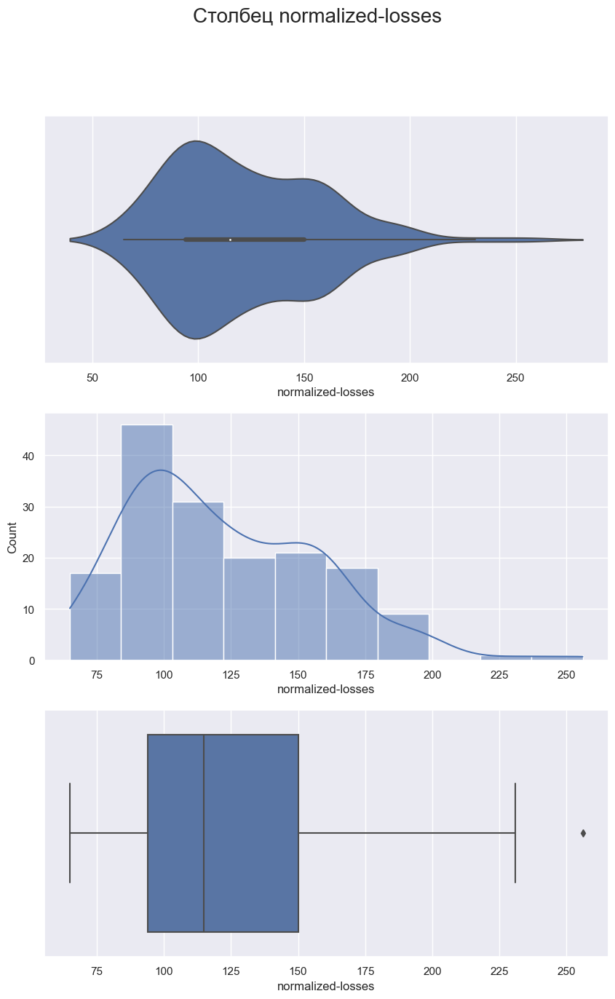

**********END**********

**********START**********


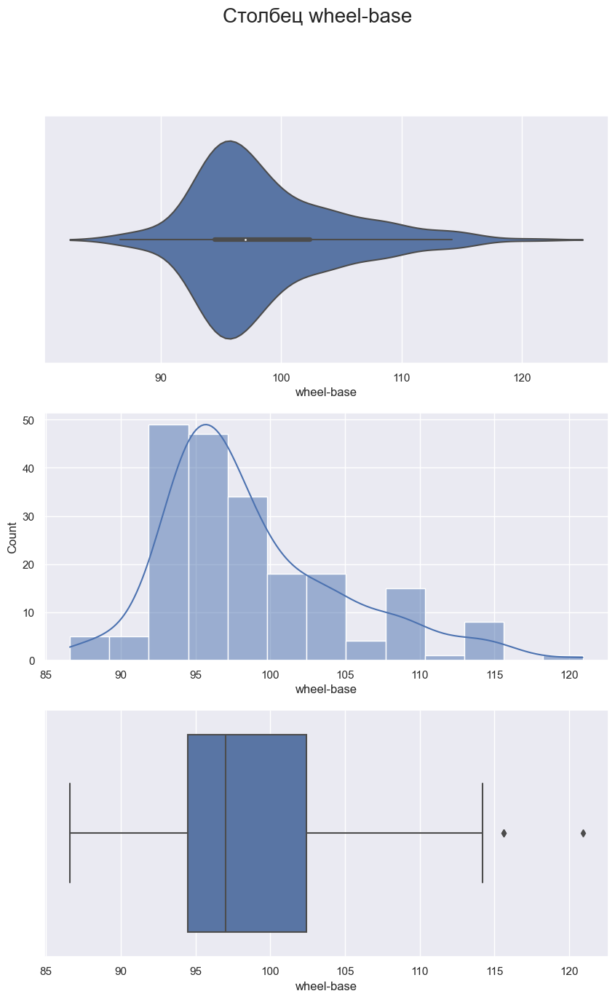

**********END**********

**********START**********


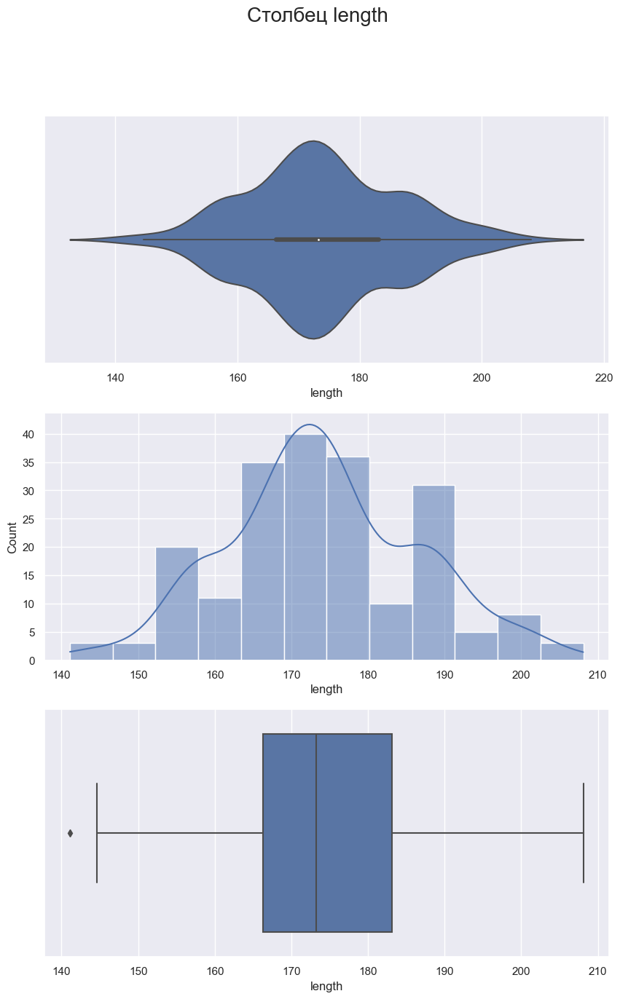

**********END**********

**********START**********


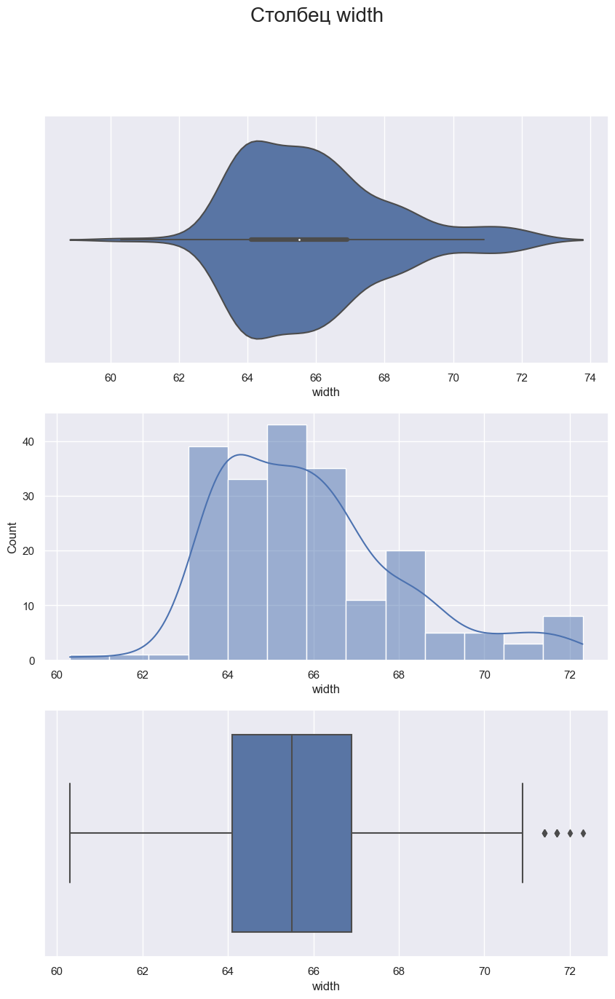

**********END**********

**********START**********


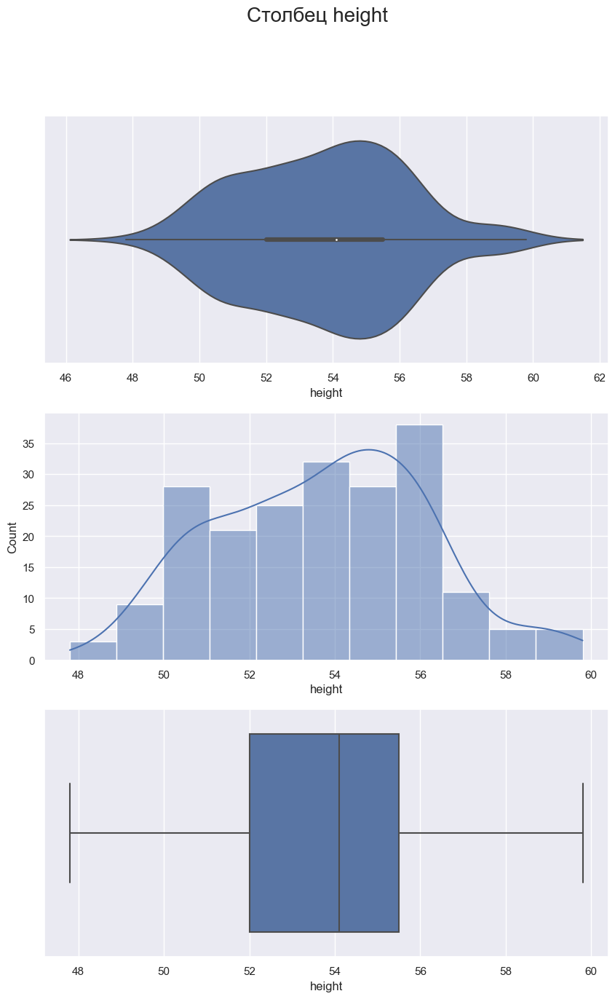

**********END**********

**********START**********


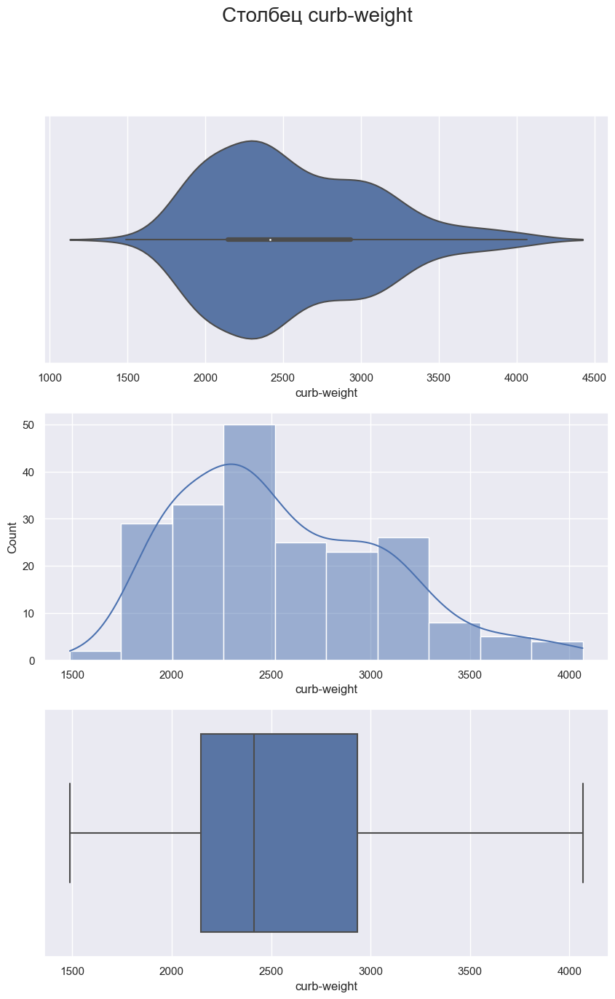

**********END**********

**********START**********


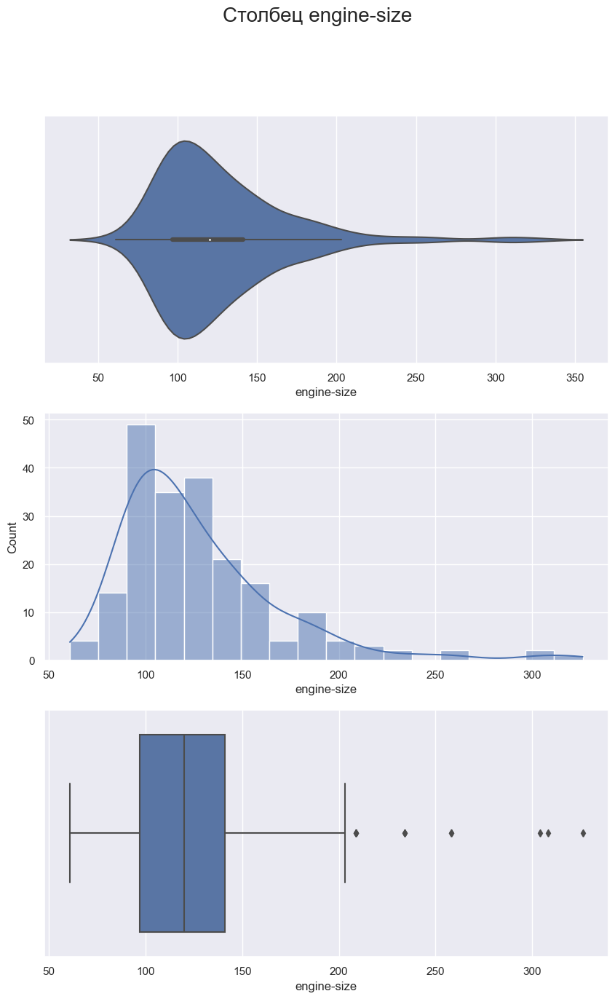

**********END**********

**********START**********


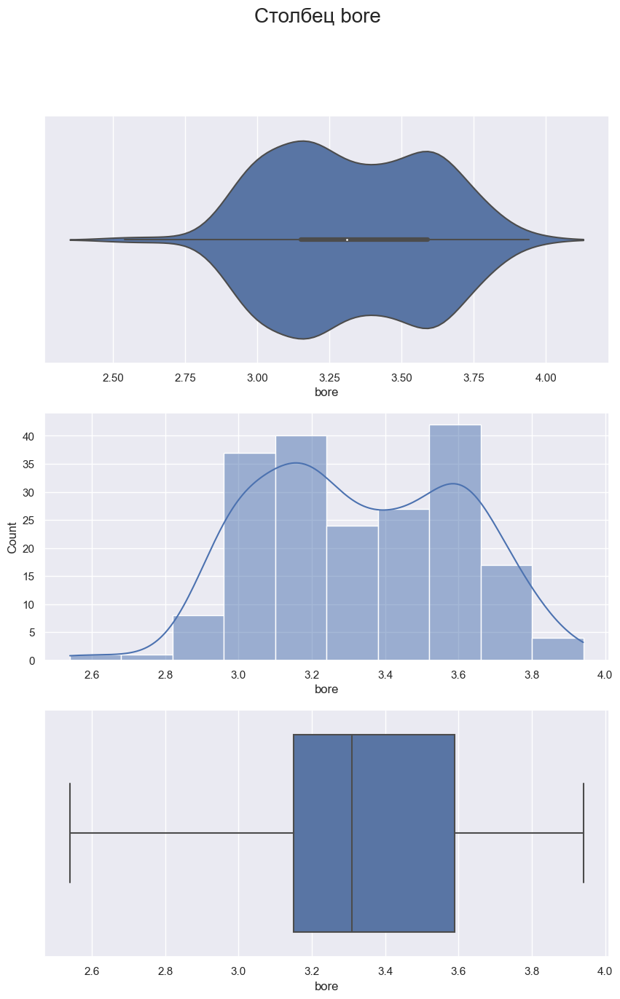

**********END**********

**********START**********


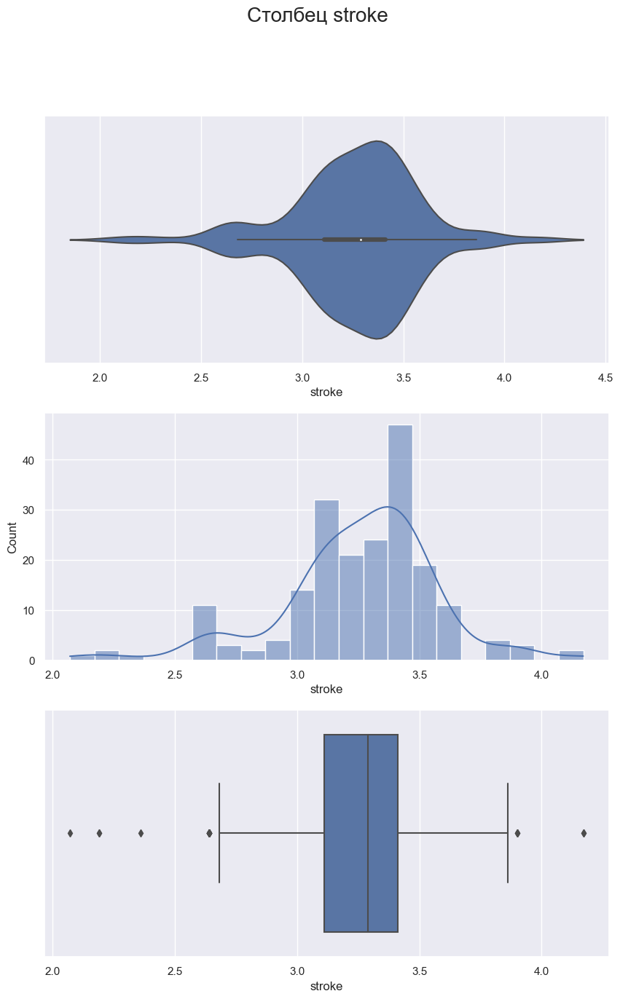

**********END**********

**********START**********


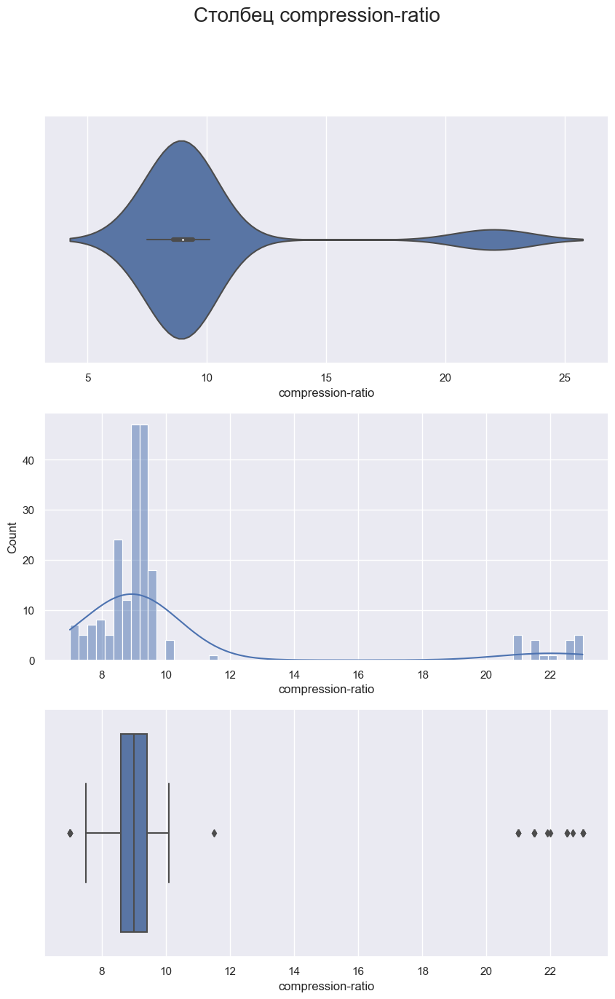

**********END**********

**********START**********


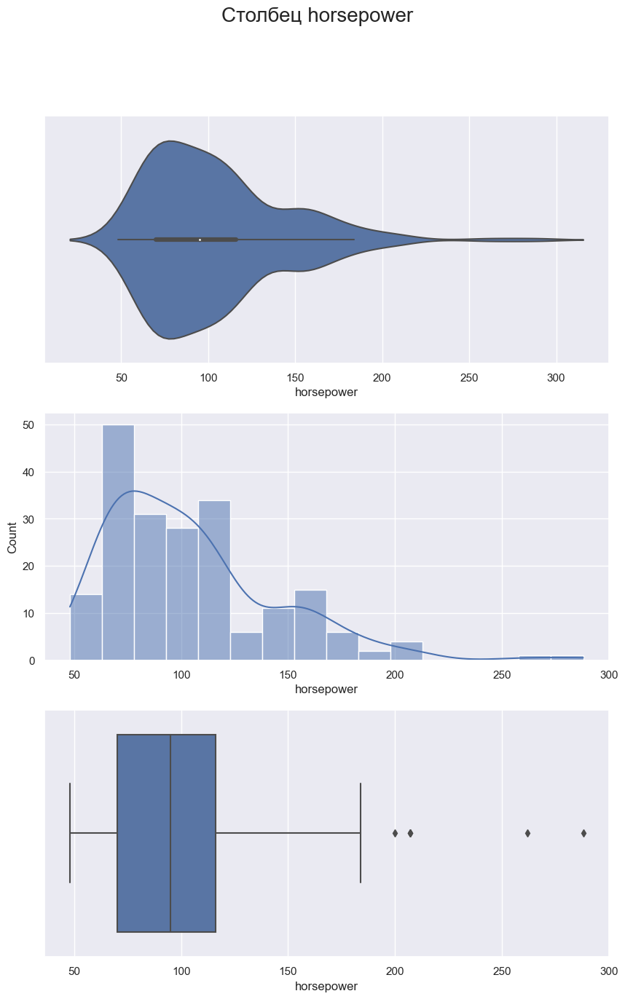

**********END**********

**********START**********


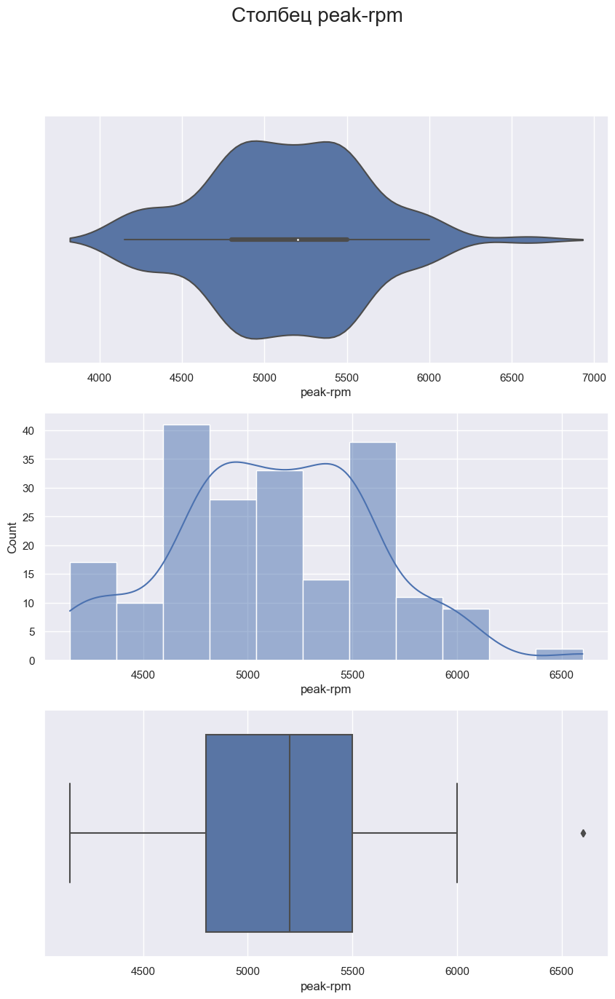

**********END**********

**********START**********


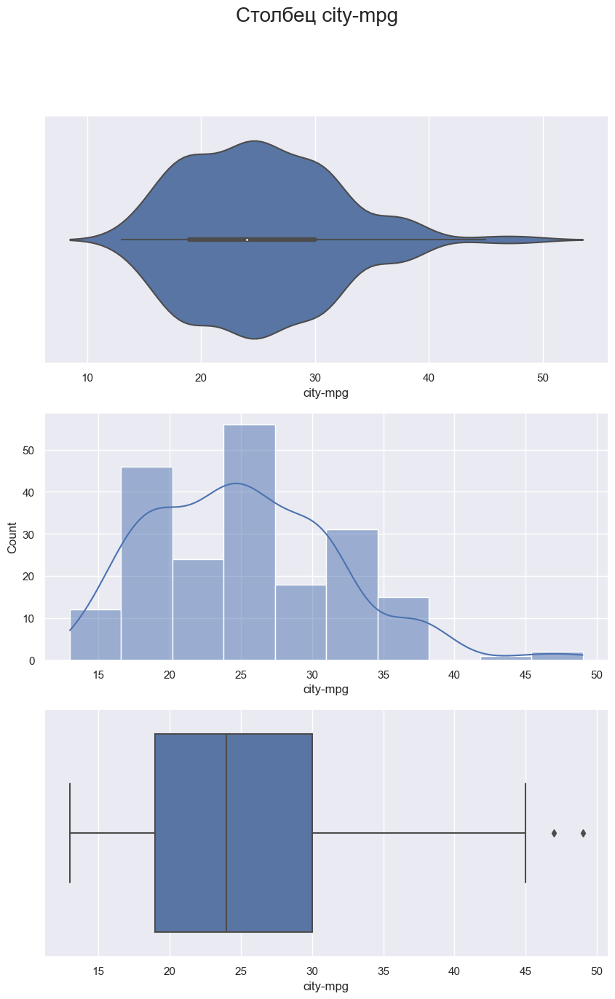

**********END**********

**********START**********


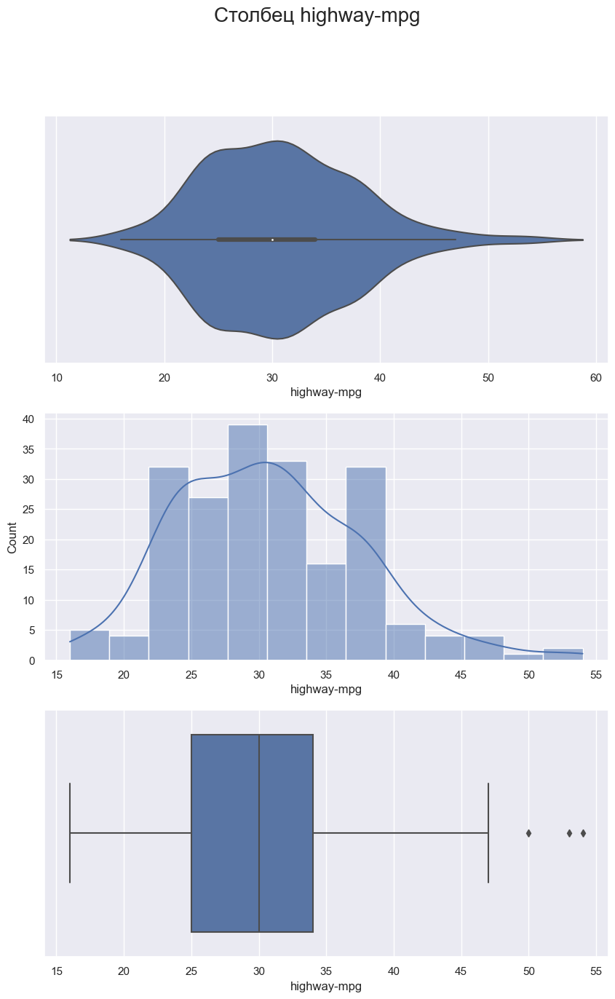

**********END**********

**********START**********


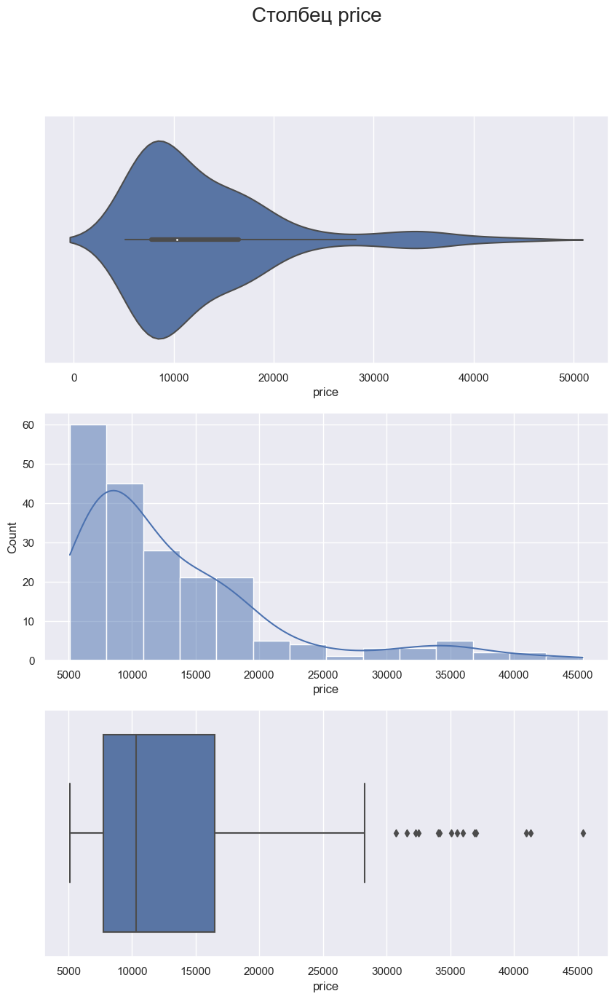

**********END**********



In [18]:
# Список числовых столбцов для анализа
column_list = ['symboling', 'normalized-losses',
       'wheel-base', 'length', 'width', 'height', 'curb-weight',
       'engine-size', 'bore', 'stroke',
       'compression-ratio', 'horsepower', 'peak-rpm', 'city-mpg',
       'highway-mpg', 'price']

# Цикл для создания графиков для каждого числового столбца
for column in column_list:
    print(f'**********START**********')
    
    # Создание нового графика с 3 подграфиками
    fig, ax = plt.subplots(3, 1, figsize=(10, 15))
    
    # Добавление общего заголовка
    fig.suptitle(f'Столбец {column}', fontsize=20)
    
    # Визуализация Violin plot (скрипичный график)
    sns.violinplot(ax=ax[0], x=df[column])
    
    # Визуализация Histogram с KDE (Kernel Density Estimation)
    sns.histplot(x=df[column], kde=True, ax=ax[1])
    
    # Визуализация Box plot (ящик с усами)
    sns.boxplot(x=df[column], ax=ax[2])
    
    # Отображение графиков
    plt.show()
    
    print('**********END**********')
    print()


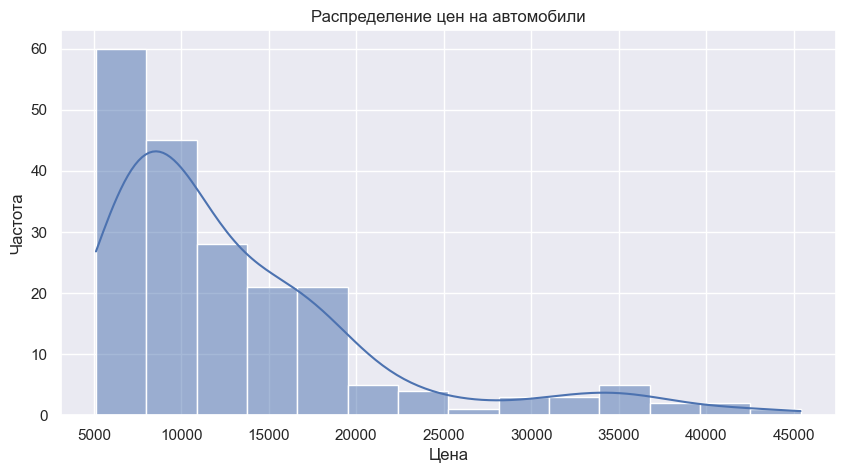

In [19]:
# Создание гистограммы для распределения цен на автомобили
plt.figure(figsize=(10, 5))

# Использование Seaborn для построения гистограммы с KDE (Kernel Density Estimation)
sns.histplot(df['price'], kde=True)

# Добавление заголовка и меток к осям
plt.title('Распределение цен на автомобили')
plt.xlabel('Цена')
plt.ylabel('Частота')

# Отображение гистограммы
plt.show()


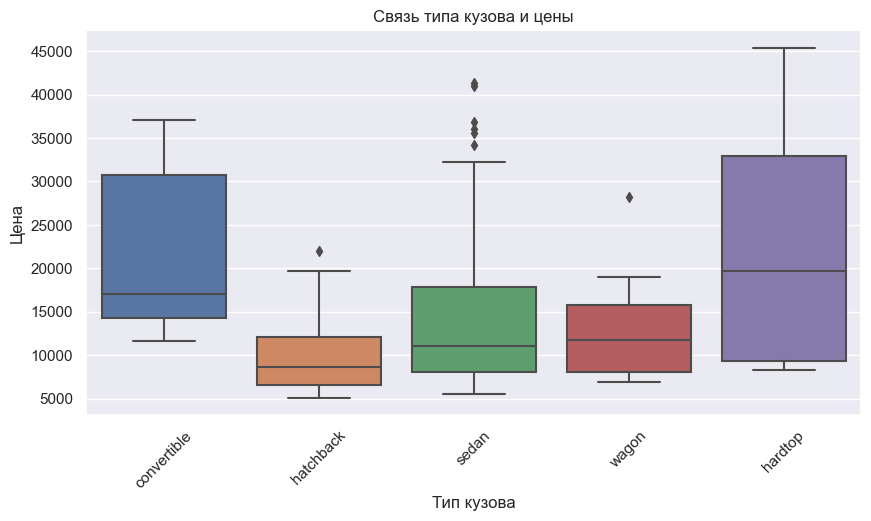

In [20]:
# Создание ящика с усами для связи типа кузова и цены
plt.figure(figsize=(10, 5))

# Использование Seaborn для построения ящика с усами
sns.boxplot(x='body-style', y='price', data=df)

# Добавление заголовка и меток к осям
plt.title('Связь типа кузова и цены')
plt.xlabel('Тип кузова')
plt.ylabel('Цена')

# Поворот меток на оси x для лучшей читаемости
plt.xticks(rotation=45)

# Отображение графика
plt.show()


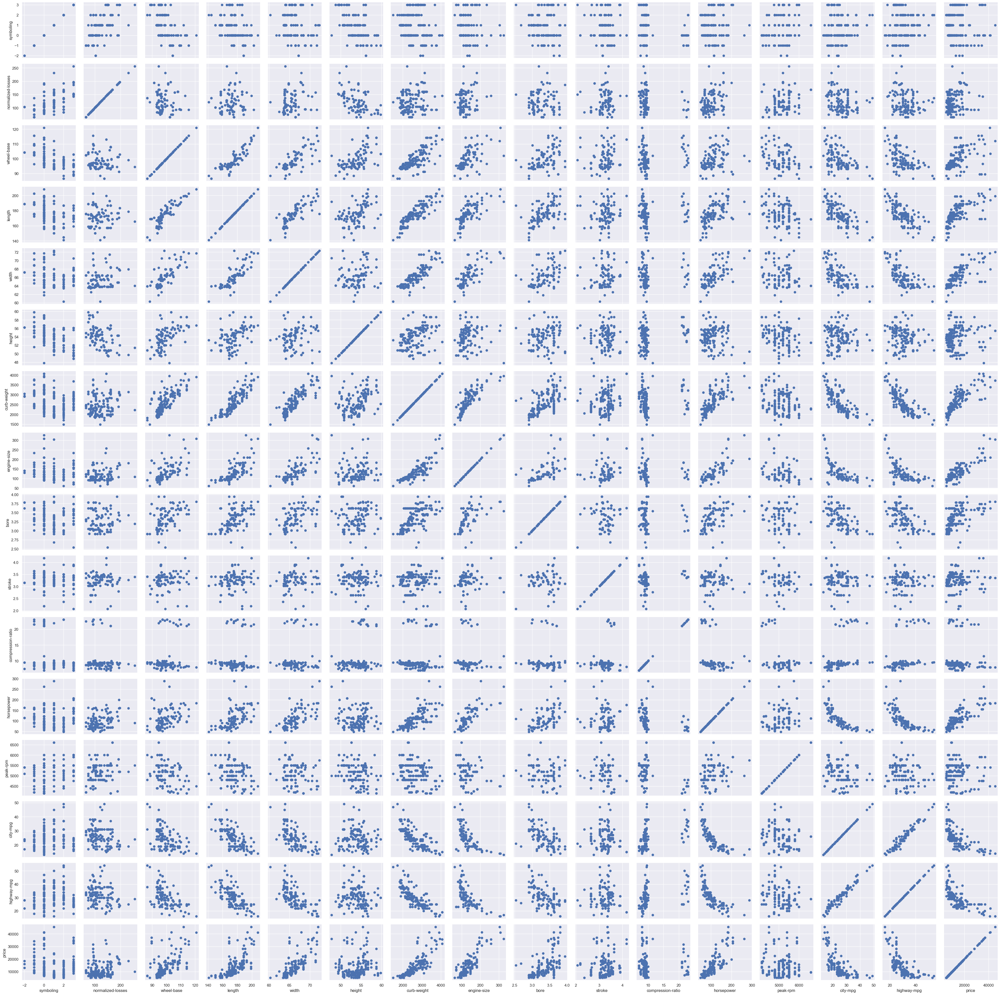

In [21]:
# Создание PairGrid для диаграммы рассеивания между парами переменных
# Это помогает визуально оценить связи и распределения между переменными.
pair_grid_plot = sns.PairGrid(df)

# Использование метода map для отображения диаграммы рассеивания на диагонали и корреляционных графиков вне диагонали
pair_grid_plot.map(plt.scatter)

# Отображение PairGrid
plt.show()


In [22]:
# корреляция Пирсона
corr = df.corr()
# Вывод матрицы корреляции
corr

# # Исключение нечисловых столбцов перед вычислением корреляции
# numeric_columns = df.select_dtypes(include=['number'])
# corr = numeric_columns.corr(numeric_only=True)

# # Вывод матрицы корреляции
# corr


,symboling,normalized-losses,wheel-base,length,width,height,curb-weight,engine-size,bore,stroke,compression-ratio,horsepower,peak-rpm,city-mpg,highway-mpg,price
symboling,1.000000,0.528667,-0.531954,-0.357612,-0.232919,-0.541038,-0.227691,-0.105790,-0.134205,-0.008965,-0.178515,0.071622,0.274573,-0.035823,0.034606,-0.082391
normalized-losses,0.528667,1.000000,-0.074362,0.023220,0.105073,-0.432335,0.119893,0.167365,-0.036167,0.065627,-0.132654,0.295772,0.264597,-0.258502,-0.210768,0.203254
wheel-base,-0.531954,-0.074362,1.000000,0.874587,0.795144,0.589435,0.776386,0.569329,0.490378,0.161477,0.249786,0.352297,-0.361052,-0.470414,-0.544082,0.584642
length,-0.357612,0.023220,0.874587,1.000000,0.841118,0.491029,0.877728,0.683360,0.607480,0.129739,0.158414,0.555003,-0.287325,-0.670909,-0.704662,0.690628
width,-0.232919,0.105073,0.795144,0.841118,1.000000,0.279210,0.867032,0.735433,0.559204,0.182956,0.181129,0.642482,-0.219957,-0.642704,-0.677218,0.751265
height,-0.541038,-0.432335,0.589435,0.491029,0.279210,1.000000,0.295572,0.067149,0.176195,-0.056999,0.261214,-0.110711,-0.322272,-0.048640,-0.107358,0.135486
curb-weight,-0.227691,0.119893,0.776386,0.877728,0.867032,0.295572,1.000000,0.850594,0.649045,0.168929,0.151362,0.751034,-0.266306,-0.757414,-0.797465,0.834415
engine-size,-0.105790,0.167365,0.569329,0.683360,0.735433,0.067149,0.850594,1.000000,0.594090,0.206675,0.028971,0.810773,-0.244618,-0.653658,-0.677470,0.872335
bore,-0.134205,-0.036167,0.490378,0.607480,0.559204,0.176195,0.649045,0.594090,1.000000,-0.055909,0.005203,0.577273,-0.264269,-0.594584,-0.594572,0.543436
stroke,-0.008965,0.065627,0.161477,0.129739,0.182956,-0.056999,0.168929,0.206675,-0.055909,1.000000,0.186170,0.090254,-0.071493,-0.042906,-0.044528,0.082310


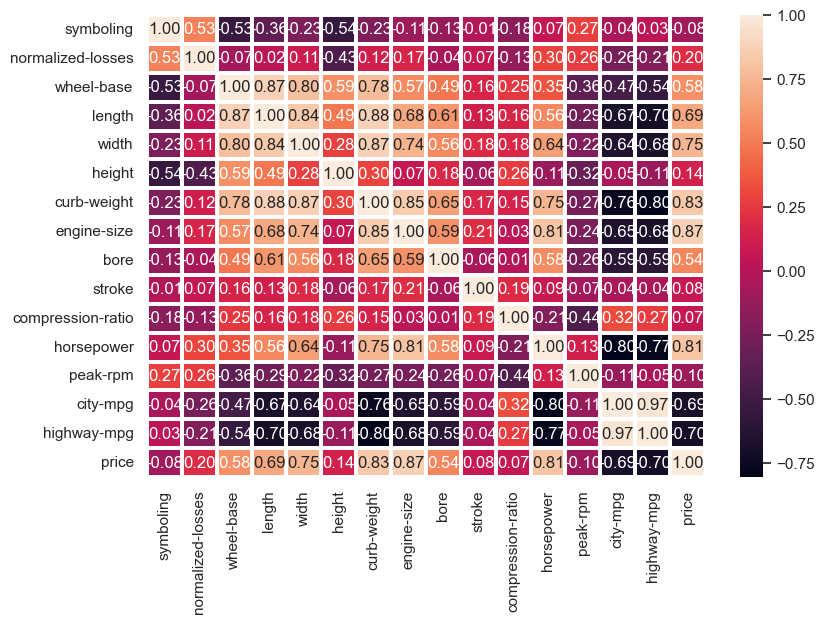

In [23]:
# Корреляция
f,ax = plt.subplots(figsize=(9,6))
sns.heatmap(corr, annot = True, linewidths=1.5 , fmt = '.2f',ax=ax)
plt.show()

График профиля переменных (Profile Plot) представляет собой визуализацию для отображения изменения значений переменных в зависимости от другой переменной или фактора. Этот тип графика полезен, когда вы хотите изучить влияние одной переменной на другие и оценить изменения в данных вдоль определенного фактора.

Основные идеи профильного графика включают:

1. **Отображение тренда**: График профиля позволяет визуально оценить изменения в значениях переменных в зависимости от значений другого фактора. Таким образом, вы можете заметить наличие трендов, возможных паттернов или корреляций.

2. **Сравнение групп**: Если переменные в профильном графике отображаются для разных групп или категорий, вы можете сравнивать их поведение. Это может помочь выявить различия или схожесть между группами.

3. **Выявление взаимодействий**: Профильные графики также используются для обнаружения взаимодействий между переменными. Например, как изменения в одной переменной влияют на изменения в другой.

Примеры ситуаций, где может быть полезен профильный график:

- **Исследование воздействия**: Оценка того, как изменение одной переменной влияет на другую (например, как изменение уровня дохода влияет на потребление товаров).

- **Мониторинг временных изменений**: Изучение того, как значения переменных меняются во времени.

- **Сравнение групп**: Анализ различий между группами в зависимости от категорий (например, как пол влияет на потребление энергии).

- **Выявление взаимодействий в эксперименте**: Понимание влияния факторов на другие переменные в рамках проведенного эксперимента.

Профильные графики являются мощным инструментом для визуализации и анализа данных, особенно в контексте изучения взаимосвязей и изменений в данных.

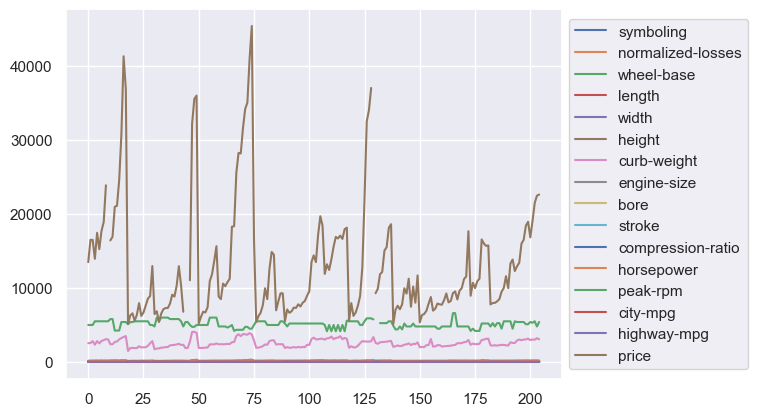

In [24]:
# График профиля для переменных из column_list
ax = df[column_list].plot()

# Размещение легенды справа от графика
ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))

# Отображение графика
plt.show()


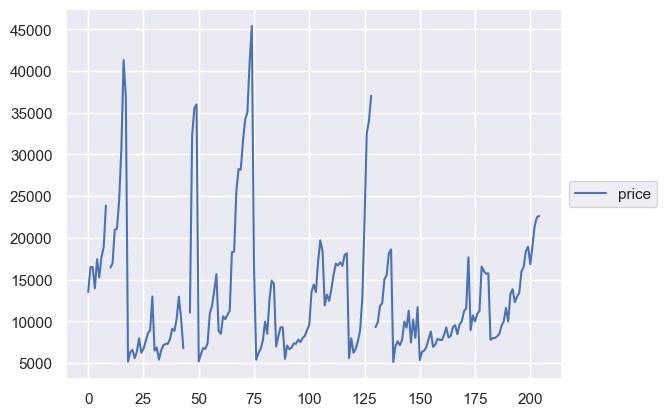

In [25]:
# Profile plot
ax = df['price'].plot()
ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))

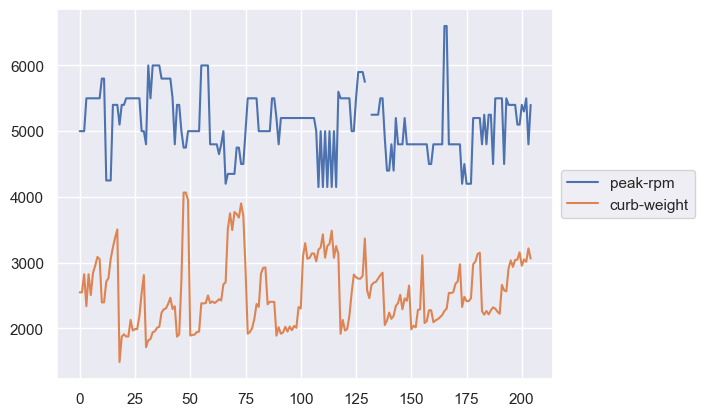

In [26]:
# Profile plot
ax = df[['peak-rpm', 'curb-weight']].plot()
ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))

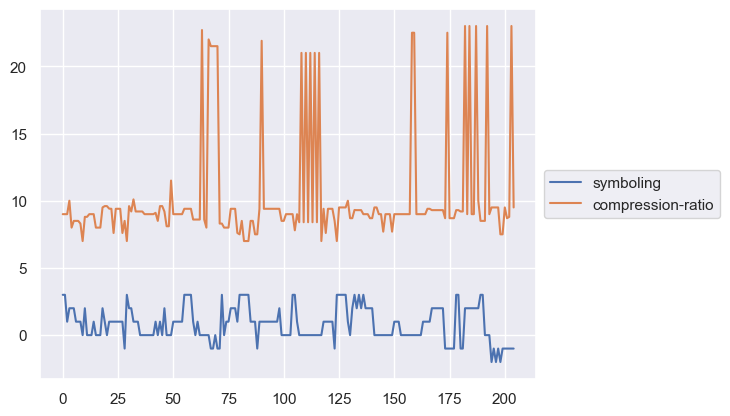

In [27]:
# Profile plot
col_list = ['symboling',
 'compression-ratio']
ax = df[col_list].plot()
ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))

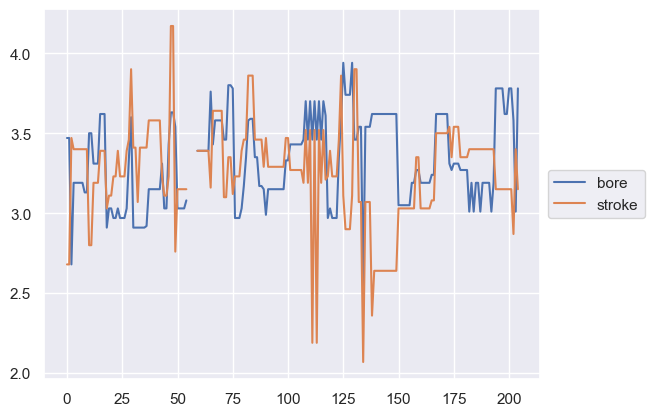

In [28]:
# Profile plot
col_list = ['bore',
 'stroke']
ax = df[col_list].plot()
ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))

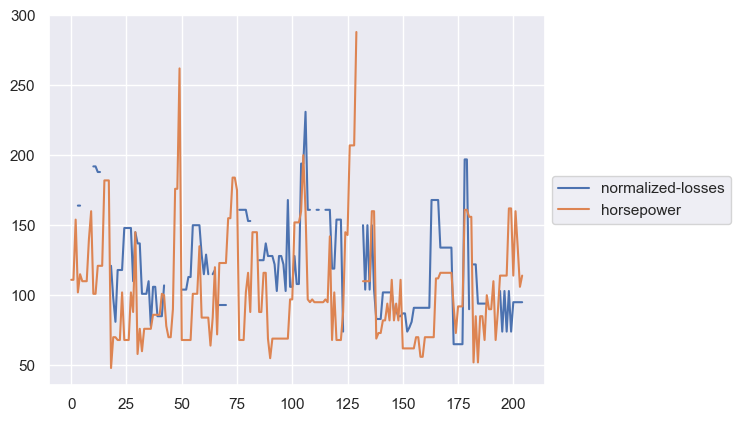

In [29]:
# Profile plot
col_list = ['normalized-losses',
 'horsepower']
ax = df[col_list].plot()
ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))

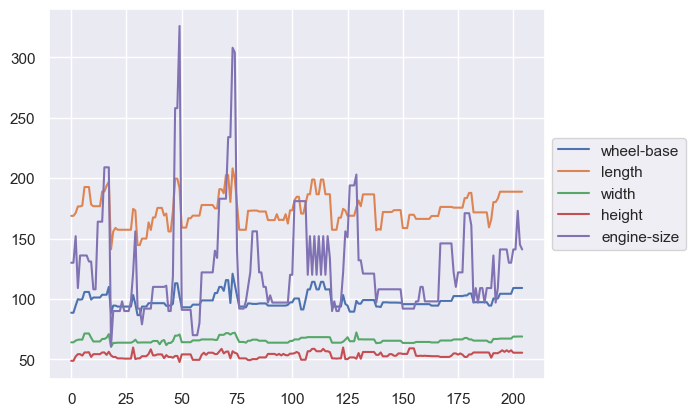

In [30]:
# Profile plot
col_list = ['wheel-base',
 'length',
 'width',
 'height',
 'engine-size']
ax = df[col_list].plot()
ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))

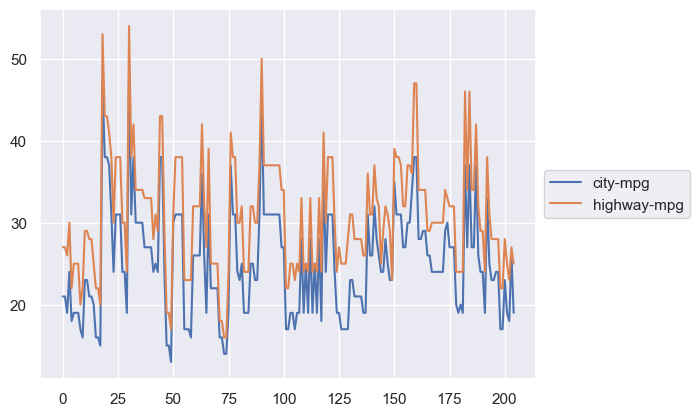

In [31]:
# Profile plot
col_list = [
 'city-mpg',
 'highway-mpg']
ax = df[col_list].plot()
ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))

# Пропуски

In [32]:
# Проверка наличия хотя бы одного пропущенного значения в каждом столбце с использованием isnull()
has_missing_values_isnull = df.isnull().any()

# Вывод результата (True, если в столбце есть хотя бы одно пропущенное значение, иначе False)
print("Наличие пропущенных значений (используя isnull()):")
print(has_missing_values_isnull)

# Проверка наличия хотя бы одного пропущенного значения в каждом столбце с использованием isna()
has_missing_values_isna = df.isna().any()

# Вывод результата (True, если в столбце есть хотя бы одно пропущенное значение, иначе False)
print("\nНаличие пропущенных значений (используя isna()):")
print(has_missing_values_isna)


Наличие пропущенных значений (используя isnull()):
symboling            False
normalized-losses     True
make                 False
fuel-type            False
aspiration           False
num-of-doors          True
body-style           False
drive-wheels         False
engine-location      False
wheel-base           False
length               False
width                False
height               False
curb-weight          False
engine-type          False
num-of-cylinders     False
engine-size          False
fuel-system          False
bore                  True
stroke                True
compression-ratio    False
horsepower            True
peak-rpm              True
city-mpg             False
highway-mpg          False
price                 True
dtype: bool

Наличие пропущенных значений (используя isna()):
symboling            False
normalized-losses     True
make                 False
fuel-type            False
aspiration           False
num-of-doors          True
body-style           Fa

In [33]:
# Подсчет количества пропущенных значений для каждого столбца с использованием isnull()
missing_values_isnull = df.isnull().sum()

# Вывод количества пропущенных значений для каждого столбца
print("Количество пропущенных значений (используя isnull()):")
print(missing_values_isnull)

# Подсчет количества пропущенных значений для каждого столбца с использованием isna()
missing_values_isna = df.isna().sum()

# Вывод количества пропущенных значений для каждого столбца
print("\nКоличество пропущенных значений (используя isna()):")
print(missing_values_isna)


Количество пропущенных значений (используя isnull()):
symboling             0
normalized-losses    41
make                  0
fuel-type             0
aspiration            0
num-of-doors          2
body-style            0
drive-wheels          0
engine-location       0
wheel-base            0
length                0
width                 0
height                0
curb-weight           0
engine-type           0
num-of-cylinders      0
engine-size           0
fuel-system           0
bore                  4
stroke                4
compression-ratio     0
horsepower            2
peak-rpm              2
city-mpg              0
highway-mpg           0
price                 4
dtype: int64

Количество пропущенных значений (используя isna()):
symboling             0
normalized-losses    41
make                  0
fuel-type             0
aspiration            0
num-of-doors          2
body-style            0
drive-wheels          0
engine-location       0
wheel-base            0
length          

у столбцов `normalized-losses` (41), `num-of-doors` (2), `bore` (4), `stroke` (4), `horsepower` (2), `peak-rpm` (2), `price` (4) есть пропуски.

In [34]:
# пропуски в категориальных переменных заполним модой
df['num-of-doors'].fillna(df['num-of-doors'].mode()[0], inplace=True)

In [35]:
# остальное заполним или средним значением или медианой. Выберем медиану
df.fillna(df.mean(numeric_only=True), inplace=True)

In [36]:
print(df.isnull().sum()) # проверка на пропуски

symboling            0
normalized-losses    0
make                 0
fuel-type            0
aspiration           0
num-of-doors         0
body-style           0
drive-wheels         0
engine-location      0
wheel-base           0
length               0
width                0
height               0
curb-weight          0
engine-type          0
num-of-cylinders     0
engine-size          0
fuel-system          0
bore                 0
stroke               0
compression-ratio    0
horsepower           0
peak-rpm             0
city-mpg             0
highway-mpg          0
price                0
dtype: int64


Пропусков больше нет

# Поиск выбросов или аномалий

Метод межквартильного размаха (Interquartile Range, IQR) является статистическим методом для выявления выбросов в данных. Он основан на интерквартильном расстоянии, которое представляет собой разницу между верхним (Q3) и нижним (Q1) квартилями данных. Квартили - это значения, которые разбивают упорядоченный набор данных на четыре равные части.

Шаги метода межквартильного размаха:

1. **Вычисление Q1 и Q3:**
   - Q1 (нижний квартиль) - значение, ниже которого находится 25% данных.
   - Q3 (верхний квартиль) - значение, ниже которого находится 75% данных.

2. **Вычисление IQR:**
   - IQR = Q3 - Q1.

3. **Определение "усов" (whiskers):**
   - Нижний ус: Q1 - 1.5 * IQR.
   - Верхний ус: Q3 + 1.5 * IQR.

4. **Выделение выбросов:**
   - Все значения, лежащие за пределами усов, считаются выбросами.

Этот метод предполагает, что большинство данных сосредоточено внутри интерквартильного размаха, и выбросы могут быть обнаружены по удаленным от этого интервала значениям. Определение коэффициента 1.5 в формуле для усов является общепринятым, но в некоторых случаях его можно изменять в зависимости от конкретной задачи.

Метод межквартильного размаха является относительно простым и быстрым способом выявления выбросов. Однако, стоит отметить, что он может не обнаруживать все выбросы, и иногда могут быть ложные срабатывания. Комбинирование этого метода с другими методами анализа выбросов может повысить надежность результата.

In [37]:
# Статистический метод (метод межквартильного размаха) - функция для поиска outliers
def find_outliers_IQR(df):
    q1 = df.quantile(0.25) # Вычисляем первый квартиль (Q1)
    
    q3 = df.quantile(0.75) # Вычисляем третий квартиль (Q3)
    
    IQR = q3 - q1 # Вычисляем межквартильный размах (IQR)
    
    # Находим выбросы, используя условие межквартильного размаха
    outliers = df[((df<(q1-1.5*IQR)) | (df>(q3+1.5*IQR)))] 
    return outliers

In [38]:
# Вызываем функцию для поиска выбросов с использованием метода межквартильного размаха
df_outliers = find_outliers_IQR(df)

# Выводим DataFrame с найденными выбросами
df_outliers


,symboling,normalized-losses,make,fuel-type,aspiration,num-of-doors,body-style,drive-wheels,engine-location,wheel-base,length,width,height,curb-weight,engine-type,num-of-cylinders,engine-size,fuel-system,bore,stroke,compression-ratio,horsepower,peak-rpm,city-mpg,highway-mpg,price
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
200,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
201,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
202,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
203,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,23.0,NaN,NaN,NaN,NaN,NaN


In [51]:
# df_outliers[df_outliers.notnull().any(1)]

# Фильтруем строки в DataFrame df_outliers, оставляя только те строки, где есть хотя бы один не-NaN элемент
df_outliers_filtered = df_outliers[df_outliers.notnull().any(1)]

# Выводим отфильтрованный DataFrame
df_outliers_filtered



,symboling,normalized-losses,make,fuel-type,aspiration,num-of-doors,body-style,drive-wheels,engine-location,wheel-base,length,width,height,curb-weight,engine-type,num-of-cylinders,engine-size,fuel-system,bore,stroke,compression-ratio,horsepower,peak-rpm,city-mpg,highway-mpg,price
6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,71.4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,71.4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,71.4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.0,NaN,NaN,NaN,NaN,NaN
10,NaN,192.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
11,NaN,192.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
15,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,209.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,30760.0
16,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,209.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,41315.0
17,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,209.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,36880.0
18,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,141.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,47.0,53.0,NaN


In [40]:
# Подсчитываем количество ненулевых (не-NaN) значений в каждом столбце DataFrame df_outliers
df_outliers.notnull().sum()

symboling             0
normalized-losses     8
make                  0
fuel-type             0
aspiration            0
num-of-doors          0
body-style            0
drive-wheels          0
engine-location       0
wheel-base            3
length                1
width                 8
height                0
curb-weight           0
engine-type           0
num-of-cylinders      0
engine-size          10
fuel-system           0
bore                  0
stroke               20
compression-ratio    28
horsepower            6
peak-rpm              2
city-mpg              2
highway-mpg           3
price                14
dtype: int64

In [41]:
# статистика outliers
stat_outliers = pd.DataFrame({'number': df_outliers.notnull().sum(),
    'min': df.min(),
    'max': df.max(),
    'mean': df.mean(numeric_only=True),
    'median':df.median(numeric_only=True)})
stat_outliers

,number,min,max,mean,median
aspiration,0,std,turbo,NaN,NaN
body-style,0,convertible,wagon,NaN,NaN
bore,0,2.54,3.94,3.329751,3.31
city-mpg,2,13,49,25.219512,24.00
compression-ratio,28,7.0,23.0,10.142537,9.00
curb-weight,0,1488,4066,2555.565854,2414.00
drive-wheels,0,4wd,rwd,NaN,NaN
engine-location,0,front,rear,NaN,NaN
engine-size,10,61,326,126.907317,120.00
engine-type,0,dohc,rotor,NaN,NaN


In [42]:
# Статистический метод (метод межквартильного размаха) для price
Q1 = df['price'].quantile(0.25)
Q3 = df['price'].quantile(0.75)
IQR = Q3 - Q1
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR
outliers_iqr = df[(df['price'] < lower_bound) | (df['price'] > upper_bound)]
outliers_iqr

,symboling,normalized-losses,make,fuel-type,aspiration,num-of-doors,body-style,drive-wheels,engine-location,wheel-base,length,width,height,curb-weight,engine-type,num-of-cylinders,engine-size,fuel-system,bore,stroke,compression-ratio,horsepower,peak-rpm,city-mpg,highway-mpg,price
15,0,122.0,bmw,gas,std,four,sedan,rwd,front,103.5,189.0,66.9,55.7,3230,ohc,six,209,mpfi,3.62,3.39,8.0,182.0,5400.0,16,22,30760.0
16,0,122.0,bmw,gas,std,two,sedan,rwd,front,103.5,193.8,67.9,53.7,3380,ohc,six,209,mpfi,3.62,3.39,8.0,182.0,5400.0,16,22,41315.0
17,0,122.0,bmw,gas,std,four,sedan,rwd,front,110.0,197.0,70.9,56.3,3505,ohc,six,209,mpfi,3.62,3.39,8.0,182.0,5400.0,15,20,36880.0
47,0,145.0,jaguar,gas,std,four,sedan,rwd,front,113.0,199.6,69.6,52.8,4066,dohc,six,258,mpfi,3.63,4.17,8.1,176.0,4750.0,15,19,32250.0
48,0,122.0,jaguar,gas,std,four,sedan,rwd,front,113.0,199.6,69.6,52.8,4066,dohc,six,258,mpfi,3.63,4.17,8.1,176.0,4750.0,15,19,35550.0
49,0,122.0,jaguar,gas,std,two,sedan,rwd,front,102.0,191.7,70.6,47.8,3950,ohcv,twelve,326,mpfi,3.54,2.76,11.5,262.0,5000.0,13,17,36000.0
70,-1,93.0,mercedes-benz,diesel,turbo,four,sedan,rwd,front,115.6,202.6,71.7,56.3,3770,ohc,five,183,idi,3.58,3.64,21.5,123.0,4350.0,22,25,31600.0
71,-1,122.0,mercedes-benz,gas,std,four,sedan,rwd,front,115.6,202.6,71.7,56.5,3740,ohcv,eight,234,mpfi,3.46,3.10,8.3,155.0,4750.0,16,18,34184.0
72,3,142.0,mercedes-benz,gas,std,two,convertible,rwd,front,96.6,180.3,70.5,50.8,3685,ohcv,eight,234,mpfi,3.46,3.10,8.3,155.0,4750.0,16,18,35056.0
73,0,122.0,mercedes-benz,gas,std,four,sedan,rwd,front,120.9,208.1,71.7,56.7,3900,ohcv,eight,308,mpfi,3.80,3.35,8.0,184.0,4500.0,14,16,40960.0


In [43]:
# Фильтруем данные, оставляя только те строки, где значение столбца 'price' больше 30,000
outliers_condition = df[df['price'] > 30000]
outliers_condition

,symboling,normalized-losses,make,fuel-type,aspiration,num-of-doors,body-style,drive-wheels,engine-location,wheel-base,length,width,height,curb-weight,engine-type,num-of-cylinders,engine-size,fuel-system,bore,stroke,compression-ratio,horsepower,peak-rpm,city-mpg,highway-mpg,price
15,0,122.0,bmw,gas,std,four,sedan,rwd,front,103.5,189.0,66.9,55.7,3230,ohc,six,209,mpfi,3.62,3.39,8.0,182.0,5400.0,16,22,30760.0
16,0,122.0,bmw,gas,std,two,sedan,rwd,front,103.5,193.8,67.9,53.7,3380,ohc,six,209,mpfi,3.62,3.39,8.0,182.0,5400.0,16,22,41315.0
17,0,122.0,bmw,gas,std,four,sedan,rwd,front,110.0,197.0,70.9,56.3,3505,ohc,six,209,mpfi,3.62,3.39,8.0,182.0,5400.0,15,20,36880.0
47,0,145.0,jaguar,gas,std,four,sedan,rwd,front,113.0,199.6,69.6,52.8,4066,dohc,six,258,mpfi,3.63,4.17,8.1,176.0,4750.0,15,19,32250.0
48,0,122.0,jaguar,gas,std,four,sedan,rwd,front,113.0,199.6,69.6,52.8,4066,dohc,six,258,mpfi,3.63,4.17,8.1,176.0,4750.0,15,19,35550.0
49,0,122.0,jaguar,gas,std,two,sedan,rwd,front,102.0,191.7,70.6,47.8,3950,ohcv,twelve,326,mpfi,3.54,2.76,11.5,262.0,5000.0,13,17,36000.0
70,-1,93.0,mercedes-benz,diesel,turbo,four,sedan,rwd,front,115.6,202.6,71.7,56.3,3770,ohc,five,183,idi,3.58,3.64,21.5,123.0,4350.0,22,25,31600.0
71,-1,122.0,mercedes-benz,gas,std,four,sedan,rwd,front,115.6,202.6,71.7,56.5,3740,ohcv,eight,234,mpfi,3.46,3.10,8.3,155.0,4750.0,16,18,34184.0
72,3,142.0,mercedes-benz,gas,std,two,convertible,rwd,front,96.6,180.3,70.5,50.8,3685,ohcv,eight,234,mpfi,3.46,3.10,8.3,155.0,4750.0,16,18,35056.0
73,0,122.0,mercedes-benz,gas,std,four,sedan,rwd,front,120.9,208.1,71.7,56.7,3900,ohcv,eight,308,mpfi,3.80,3.35,8.0,184.0,4500.0,14,16,40960.0


Медиана абсолютного отклонения (Median Absolute Deviation, MAD) - это статистический метод для выявления выбросов в данных. Этот метод использует медиану для измерения среднего абсолютного отклонения каждого элемента данных от медианы всего набора данных. 

Шаги метода MAD:

1. **Вычисление медианы (Me):**
   - Находим медиану всего набора данных.

2. **Вычисление абсолютных отклонений:**
   - Для каждого элемента данных вычисляем абсолютное отклонение от медианы: \( |X_i - Me| \).

3. **Вычисление медианы абсолютных отклонений (MAD):**
   - Находим медиану полученных абсолютных отклонений.

4. **Установление порога для определения выбросов:**
   - Традиционно, порог для определения выбросов принимают в виде множителя, умноженного на MAD. Если абсолютное отклонение от медианы превышает установленный порог, то значение считается выбросом.

Математически это можно представить как:
$[ \text{Выброс} = |X_i - Me| > k \times \text{MAD}, ]$
где \( k \) - множитель, обычно равный 2 или 3, и может быть настроен в зависимости от конкретной задачи.

Метод MAD является устойчивым к выбросам методом, так как он использует медиану вместо среднего значения, что делает его менее чувствительным к крайним значениям. Он также работает хорошо для данных, которые не подчиняются нормальному распределению. Однако, как и в случае других методов, определение конкретного значения для множителя \( k \) может потребовать некоторой настройки в зависимости от конкретной ситуации.

In [44]:
# Вычисляем медиану и медиану абсолютного отклонения (MAD) для столбца 'price'
median = df['price'].median()
mad = np.median(np.abs(df['price'] - median))

# Задаем порог для определения выбросов с использованием MAD
threshold_mad = 3.5

# Вычисляем нижнюю и верхнюю границы для определения выбросов по методу MAD
lower_bound_mad = median - (threshold_mad * mad)
upper_bound_mad = median + (threshold_mad * mad)

# Находим выбросы с использованием границ MAD
outliers_mad = df[(df['price'] < lower_bound_mad) | (df['price'] > upper_bound_mad)]

outliers_mad

,symboling,normalized-losses,make,fuel-type,aspiration,num-of-doors,body-style,drive-wheels,engine-location,wheel-base,length,width,height,curb-weight,engine-type,num-of-cylinders,engine-size,fuel-system,bore,stroke,compression-ratio,horsepower,peak-rpm,city-mpg,highway-mpg,price
8,1,158.0,audi,gas,turbo,four,sedan,fwd,front,105.8,192.7,71.4,55.9,3086,ohc,five,131,mpfi,3.13,3.40,8.3,140.0,5500.0,17,20,23875.0
14,1,122.0,bmw,gas,std,four,sedan,rwd,front,103.5,189.0,66.9,55.7,3055,ohc,six,164,mpfi,3.31,3.19,9.0,121.0,4250.0,20,25,24565.0
15,0,122.0,bmw,gas,std,four,sedan,rwd,front,103.5,189.0,66.9,55.7,3230,ohc,six,209,mpfi,3.62,3.39,8.0,182.0,5400.0,16,22,30760.0
16,0,122.0,bmw,gas,std,two,sedan,rwd,front,103.5,193.8,67.9,53.7,3380,ohc,six,209,mpfi,3.62,3.39,8.0,182.0,5400.0,16,22,41315.0
17,0,122.0,bmw,gas,std,four,sedan,rwd,front,110.0,197.0,70.9,56.3,3505,ohc,six,209,mpfi,3.62,3.39,8.0,182.0,5400.0,15,20,36880.0
47,0,145.0,jaguar,gas,std,four,sedan,rwd,front,113.0,199.6,69.6,52.8,4066,dohc,six,258,mpfi,3.63,4.17,8.1,176.0,4750.0,15,19,32250.0
48,0,122.0,jaguar,gas,std,four,sedan,rwd,front,113.0,199.6,69.6,52.8,4066,dohc,six,258,mpfi,3.63,4.17,8.1,176.0,4750.0,15,19,35550.0
49,0,122.0,jaguar,gas,std,two,sedan,rwd,front,102.0,191.7,70.6,47.8,3950,ohcv,twelve,326,mpfi,3.54,2.76,11.5,262.0,5000.0,13,17,36000.0
67,-1,93.0,mercedes-benz,diesel,turbo,four,sedan,rwd,front,110.0,190.9,70.3,56.5,3515,ohc,five,183,idi,3.58,3.64,21.5,123.0,4350.0,22,25,25552.0
68,-1,93.0,mercedes-benz,diesel,turbo,four,wagon,rwd,front,110.0,190.9,70.3,58.7,3750,ohc,five,183,idi,3.58,3.64,21.5,123.0,4350.0,22,25,28248.0


# Бонус (для общего развития): Модельные методы обнаружения выбросов
Необязательная часть для выполнения вашего проекта по EDA (разведочному анализу данных)
## IsolationForest

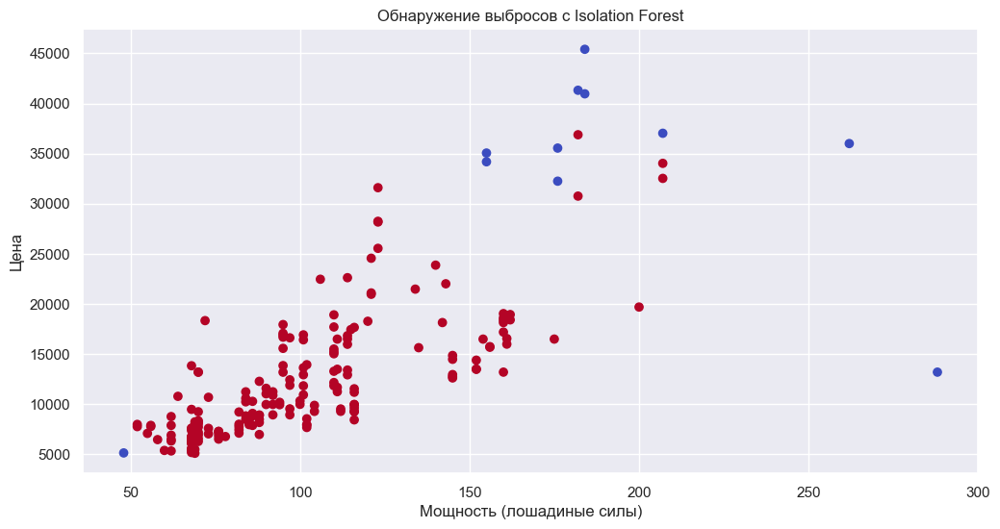

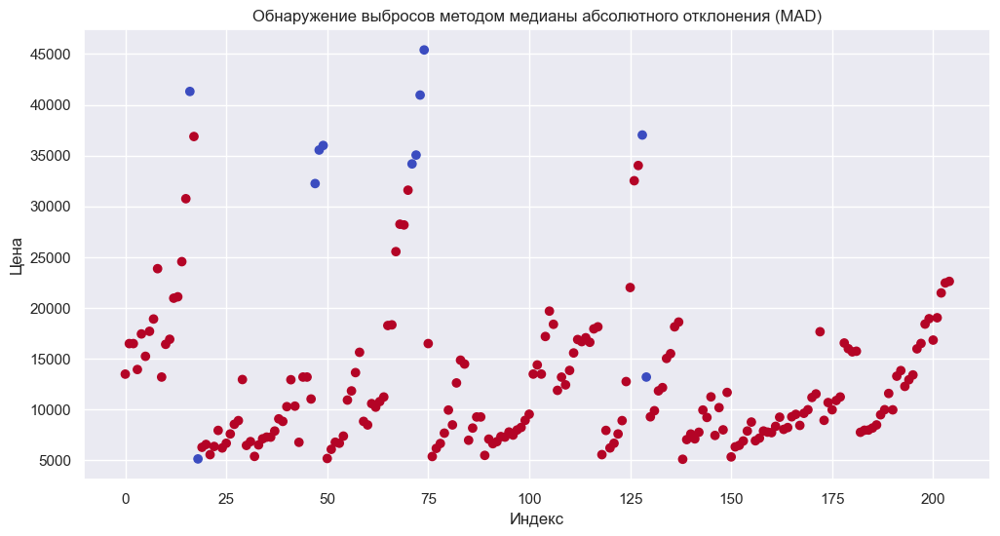

In [45]:
# Обнаружение выбросов с использованием Isolation Forest
clf = IsolationForest(contamination=0.05, random_state=42)
outliers_iforest = clf.fit_predict(df[['price', 'horsepower', 'engine-size']])
df['outlier_iforest'] = outliers_iforest

# Визуализация выбросов с Isolation Forest
plt.figure(figsize=(12, 6))
plt.scatter(df['horsepower'], df['price'], c=df['outlier_iforest'], cmap='coolwarm')
plt.title('Обнаружение выбросов с Isolation Forest')
plt.xlabel('Мощность (лошадиные силы)')
plt.ylabel('Цена')
plt.show()

# # Визуализация выбросов методом межквартильного размаха
# plt.figure(figsize=(12, 6))
# sns.boxplot(x='body-style', y='price', data=outliers_iqr)
# plt.title('Выбросы: Тип кузова и цена (метод IQR)')
# plt.xlabel('Тип кузова')
# plt.ylabel('Цена')
# plt.xticks(rotation=45)
# plt.show()

# Визуализация выбросов методом медианы абсолютного отклонения
plt.figure(figsize=(12, 6))
plt.scatter(df.index, df['price'], c=df['outlier_iforest'], cmap='coolwarm')
plt.title('Обнаружение выбросов методом медианы абсолютного отклонения (MAD)')
plt.xlabel('Индекс')
plt.ylabel('Цена')
plt.show()


## Модели поиска выбросов One-Class SVM и Local Outlier Factor

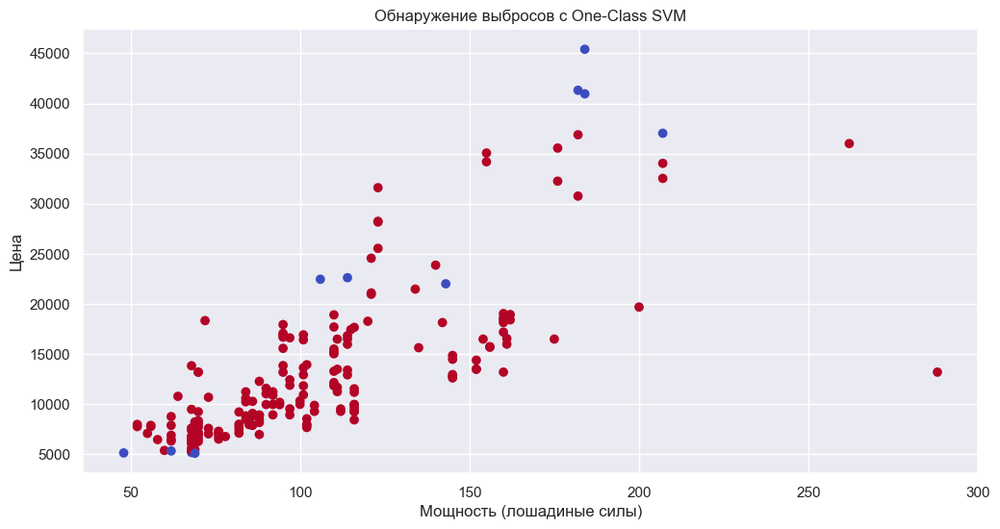

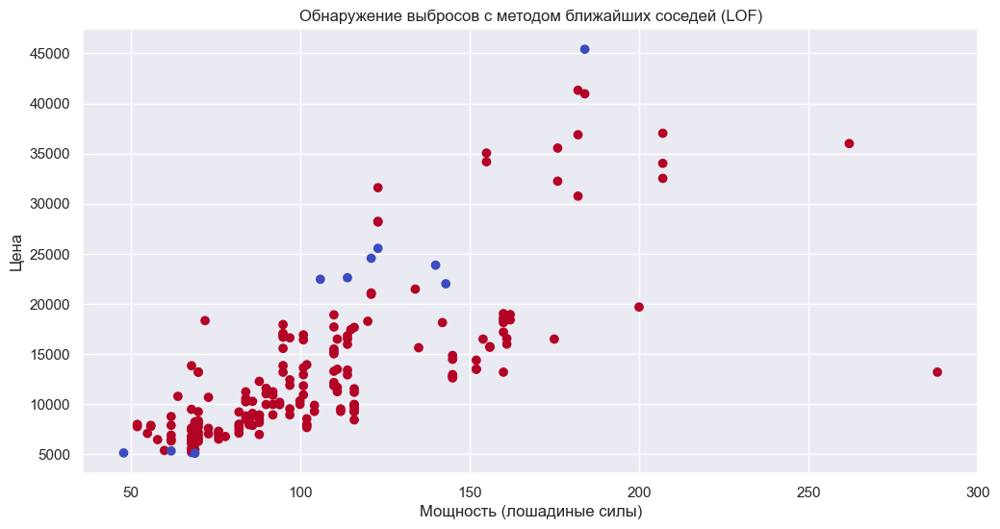

In [46]:
# Обнаружение выбросов с использованием One-Class SVM
model_svm = OneClassSVM(nu=0.05)
outliers_svm = model_svm.fit_predict(df[['price', 'horsepower', 'engine-size']])
df['outlier_svm'] = outliers_svm

# Визуализация выбросов с One-Class SVM
plt.figure(figsize=(12, 6))
plt.scatter(df['horsepower'], df['price'], c=df['outlier_svm'], cmap='coolwarm')
plt.title('Обнаружение выбросов с One-Class SVM')
plt.xlabel('Мощность (лошадиные силы)')
plt.ylabel('Цена')
plt.show()

# Обнаружение выбросов с использованием метода ближайших соседей (Local Outlier Factor)
model_lof = LocalOutlierFactor(n_neighbors=20, contamination=0.05)
outliers_lof = model_lof.fit_predict(df[['price', 'horsepower', 'engine-size']])
df['outlier_lof'] = outliers_lof

# Визуализация выбросов с методом ближайших соседей
plt.figure(figsize=(12, 6))
plt.scatter(df['horsepower'], df['price'], c=df['outlier_lof'], cmap='coolwarm')
plt.title('Обнаружение выбросов с методом ближайших соседей (LOF)')
plt.xlabel('Мощность (лошадиные силы)')
plt.ylabel('Цена')
plt.show()

In [47]:
df

,symboling,normalized-losses,make,fuel-type,aspiration,num-of-doors,body-style,drive-wheels,engine-location,wheel-base,length,width,height,curb-weight,engine-type,num-of-cylinders,engine-size,fuel-system,bore,stroke,compression-ratio,horsepower,peak-rpm,city-mpg,highway-mpg,price,outlier_iforest,outlier_svm,outlier_lof
0,3,122.0,alfa-romero,gas,std,two,convertible,rwd,front,88.6,168.8,64.1,48.8,2548,dohc,four,130,mpfi,3.47,2.68,9.0,111.0,5000.0,21,27,13495.0,1,1,1
1,3,122.0,alfa-romero,gas,std,two,convertible,rwd,front,88.6,168.8,64.1,48.8,2548,dohc,four,130,mpfi,3.47,2.68,9.0,111.0,5000.0,21,27,16500.0,1,1,1
2,1,122.0,alfa-romero,gas,std,two,hatchback,rwd,front,94.5,171.2,65.5,52.4,2823,ohcv,six,152,mpfi,2.68,3.47,9.0,154.0,5000.0,19,26,16500.0,1,1,1
3,2,164.0,audi,gas,std,four,sedan,fwd,front,99.8,176.6,66.2,54.3,2337,ohc,four,109,mpfi,3.19,3.40,10.0,102.0,5500.0,24,30,13950.0,1,1,1
4,2,164.0,audi,gas,std,four,sedan,4wd,front,99.4,176.6,66.4,54.3,2824,ohc,five,136,mpfi,3.19,3.40,8.0,115.0,5500.0,18,22,17450.0,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
200,-1,95.0,volvo,gas,std,four,sedan,rwd,front,109.1,188.8,68.9,55.5,2952,ohc,four,141,mpfi,3.78,3.15,9.5,114.0,5400.0,23,28,16845.0,1,1,1
201,-1,95.0,volvo,gas,turbo,four,sedan,rwd,front,109.1,188.8,68.8,55.5,3049,ohc,four,141,mpfi,3.78,3.15,8.7,160.0,5300.0,19,25,19045.0,1,1,1
202,-1,95.0,volvo,gas,std,four,sedan,rwd,front,109.1,188.8,68.9,55.5,3012,ohcv,six,173,mpfi,3.58,2.87,8.8,134.0,5500.0,18,23,21485.0,1,1,1
203,-1,95.0,volvo,diesel,turbo,four,sedan,rwd,front,109.1,188.8,68.9,55.5,3217,ohc,six,145,idi,3.01,3.40,23.0,106.0,4800.0,26,27,22470.0,1,-1,-1


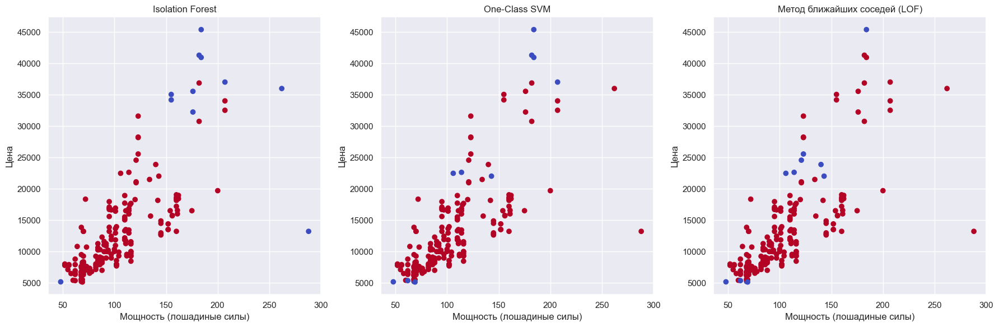

Количество выбросов (Isolation Forest): 11
Количество выбросов (One-Class SVM): 11
Количество выбросов (Метод ближайших соседей): 11


In [48]:
# Визуализация результатов выбросов для каждого метода
plt.figure(figsize=(18, 6))

# Isolation Forest
plt.subplot(131)
plt.scatter(df['horsepower'], df['price'], c=df['outlier_iforest'], cmap='coolwarm')
plt.title('Isolation Forest')
plt.xlabel('Мощность (лошадиные силы)')
plt.ylabel('Цена')

# One-Class SVM
plt.subplot(132)
plt.scatter(df['horsepower'], df['price'], c=df['outlier_svm'], cmap='coolwarm')
plt.title('One-Class SVM')
plt.xlabel('Мощность (лошадиные силы)')
plt.ylabel('Цена')

# Метод ближайших соседей (Local Outlier Factor)
plt.subplot(133)
plt.scatter(df['horsepower'], df['price'], c=df['outlier_lof'], cmap='coolwarm')
plt.title('Метод ближайших соседей (LOF)')
plt.xlabel('Мощность (лошадиные силы)')
plt.ylabel('Цена')

plt.tight_layout()
plt.show()

# Сравнение количества выбросов для каждого метода
outliers_count_iforest = len(df[df['outlier_iforest'] == -1])
outliers_count_svm = len(df[df['outlier_svm'] == -1])
outliers_count_lof = len(df[df['outlier_lof'] == -1])

print("Количество выбросов (Isolation Forest):", outliers_count_iforest)
print("Количество выбросов (One-Class SVM):", outliers_count_svm)
print("Количество выбросов (Метод ближайших соседей):", outliers_count_lof)
